# Advanced Regression Assignment Part -1

## Problem Statement

Surprise Housing, a US-based real estate company, is expanding its operations to the Australian market and aims to leverage data analytics to identify lucrative investment opportunities. To achieve this, the company has compiled a dataset from the Australian housing market, which is provided in the accompanying CSV file. The objective is to develop a regression model with regularization techniques to predict the true values of potential properties. This predictive model will aid Surprise Housing in making informed decisions about whether to invest in these properties. The key questions the company wants to address include identifying the significant variables influencing house prices and assessing how effectively these variables explain variations in property prices. Additionally, the analysis aims to determine the optimal values of lambda for both ridge and lasso regression, providing valuable insights for the company's investment strategy in the Australian real estate market.

## Solution Approach
This assignment is divided into multiple parts, which are
1. Data Initiation and Viewing the DF
    1. Importing libraries
    2. Initializing the dataset into DF
2. Data Preparation
    1. Data Cleansing - Null imputation
    2. Columns type modification
3. EDA
    1. Uni-Variate Analysis
    2. Bi- variate analysis, 
    3. Heatmap
    4. Creating Dummies
4. Model Building
    1. Linear Regression model without Ridge/Lasso
    2. Ridge Regression Model
    3. Lasso Regression Model
5. Conclusion
    1. Differences between Ridge & Lasso
    2. Selection of top features


## 1. Data Initiation and Viewing the DF

### Importing Libraries

In [2]:
# Let's import all the necessary libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
pd.options.display.max_rows = None
pd.options.display.max_columns = None

from sklearn.preprocessing import PolynomialFeatures, MinMaxScaler
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import GridSearchCV
from sklearn import metrics
from sklearn.model_selection import train_test_split



import warnings
warnings.filterwarnings('ignore')

### Loading CSV to a DF

In [4]:
df = pd.read_csv('train.csv')
df.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,0,150,856,GasA,Ex,Y,SBrkr,856,854,0,1710,1,0,2,1,3,1,Gd,8,Typ,0,NaN,Attchd,2003.0,RFn,2,548,TA,TA,Y,0,61,0,0,0,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,0,284,1262,GasA,Ex,Y,SBrkr,1262,0,0,1262,0,1,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976.0,RFn,2,460,TA,TA,Y,298,0,0,0,0,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,0,434,920,GasA,Ex,Y,SBrkr,920,866,0,1786,1,0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001.0,RFn,2,608,TA,TA,Y,0,42,0,0,0,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,0,540,756,GasA,Gd,Y,SBrkr,961,756,0,1717,1,0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998.0,Unf,3,642,TA,TA,Y,0,35,272,0,0,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,0,490,1145,GasA,Ex,Y,SBrkr,1145,1053,0,2198,1,0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000.0,RFn,3,836,TA,TA,Y,192,84,0,0,0,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 81 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1460 non-null   int64  
 1   MSSubClass     1460 non-null   int64  
 2   MSZoning       1460 non-null   object 
 3   LotFrontage    1201 non-null   float64
 4   LotArea        1460 non-null   int64  
 5   Street         1460 non-null   object 
 6   Alley          91 non-null     object 
 7   LotShape       1460 non-null   object 
 8   LandContour    1460 non-null   object 
 9   Utilities      1460 non-null   object 
 10  LotConfig      1460 non-null   object 
 11  LandSlope      1460 non-null   object 
 12  Neighborhood   1460 non-null   object 
 13  Condition1     1460 non-null   object 
 14  Condition2     1460 non-null   object 
 15  BldgType       1460 non-null   object 
 16  HouseStyle     1460 non-null   object 
 17  OverallQual    1460 non-null   int64  
 18  OverallC

In [6]:
df.describe()

,Id,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
count,1460.000000,1460.000000,1201.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1452.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1379.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000
mean,730.500000,56.897260,70.049958,10516.828082,6.099315,5.575342,1971.267808,1984.865753,103.685262,443.639726,46.549315,567.240411,1057.429452,1162.626712,346.992466,5.844521,1515.463699,0.425342,0.057534,1.565068,0.382877,2.866438,1.046575,6.517808,0.613014,1978.506164,1.767123,472.980137,94.244521,46.660274,21.954110,3.409589,15.060959,2.758904,43.489041,6.321918,2007.815753,180921.195890
std,421.610009,42.300571,24.284752,9981.264932,1.382997,1.112799,30.202904,20.645407,181.066207,456.098091,161.319273,441.866955,438.705324,386.587738,436.528436,48.623081,525.480383,0.518911,0.238753,0.550916,0.502885,0.815778,0.220338,1.625393,0.644666,24.689725,0.747315,213.804841,125.338794,66.256028,61.119149,29.317331,55.757415,40.177307,496.123024,2.703626,1.328095,79442.502883
min,1.000000,20.000000,21.000000,1300.000000,1.000000,1.000000,1872.000000,1950.000000,0.000000,0.000000,0.000000,0.000000,0.000000,334.000000,0.000000,0.000000,334.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,0.000000,1900.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,2006.000000,34900.000000
25%,365.750000,20.000000,59.000000,7553.500000,5.000000,5.000000,1954.000000,1967.000000,0.000000,0.000000,0.000000,223.000000,795.750000,882.000000,0.000000,0.000000,1129.500000,0.000000,0.000000,1.000000,0.000000,2.000000,1.000000,5.000000,0.000000,1961.000000,1.000000,334.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5.000000,2007.000000,129975.000000
50%,730.500000,50.000000,69.000000,9478.500000,6.000000,5.000000,1973.000000,1994.000000,0.000000,383.500000,0.000000,477.500000,991.500000,1087.000000,0.000000,0.000000,1464.000000,0.000000,0.000000,2.000000,0.000000,3.000000,1.000000,6.000000,1.000000,1980.000000,2.000000,480.000000,0.000000,25.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000,2008.000000,163000.000000
75%,1095.250000,70.000000,80.000000,11601.500000,7.000000,6.000000,2000.000000,2004.000000,166.000000,712.250000,0.000000,808.000000,1298.250000,1391.250000,728.000000,0.000000,1776.750000,1.000000,0.000000,2.000000,1.000000,3.000000,1.000000,7.000000,1.000000,2002.000000,2.000000,576.000000,168.000000,68.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8.000000,2009.000000,214000.000000
max,1460.000000,190.000000,313.000000,215245.000000,10.000000,9.000000,2010.000000,2010.000000,1600.000000,5644.000000,1474.000000,2336.000000,6110.000000,4692.000000,2065.000000,572.000000,5642.000000,3.000000,2.000000,3.000000,2.000000,8.000000,3.000000,14.000000,3.000000,2010.000000,4.000000,1418.000000,857.000000,547.000000,552.000000,508.000000,480.000000,738.000000,15500.000000,12.000000,2010.000000,755000.000000


In [7]:
df.shape

(1460, 81)

## 2. Data Preparation

### Check for Duplicates if any

In [8]:
duplicates = df[df.duplicated()]
print(duplicates)

Empty DataFrame
Columns: [Id, MSSubClass, MSZoning, LotFrontage, LotArea, Street, Alley, LotShape, LandContour, Utilities, LotConfig, LandSlope, Neighborhood, Condition1, Condition2, BldgType, HouseStyle, OverallQual, OverallCond, YearBuilt, YearRemodAdd, RoofStyle, RoofMatl, Exterior1st, Exterior2nd, MasVnrType, MasVnrArea, ExterQual, ExterCond, Foundation, BsmtQual, BsmtCond, BsmtExposure, BsmtFinType1, BsmtFinSF1, BsmtFinType2, BsmtFinSF2, BsmtUnfSF, TotalBsmtSF, Heating, HeatingQC, CentralAir, Electrical, 1stFlrSF, 2ndFlrSF, LowQualFinSF, GrLivArea, BsmtFullBath, BsmtHalfBath, FullBath, HalfBath, BedroomAbvGr, KitchenAbvGr, KitchenQual, TotRmsAbvGrd, Functional, Fireplaces, FireplaceQu, GarageType, GarageYrBlt, GarageFinish, GarageCars, GarageArea, GarageQual, GarageCond, PavedDrive, WoodDeckSF, OpenPorchSF, EnclosedPorch, 3SsnPorch, ScreenPorch, PoolArea, PoolQC, Fence, MiscFeature, MiscVal, MoSold, YrSold, SaleType, SaleCondition, SalePrice]
Index: []


No Duplicates present in our DF

### Check for Nulls

In [9]:
round(df.isnull().sum()/len(df)*100,2)

Id                0.00
MSSubClass        0.00
MSZoning          0.00
LotFrontage      17.74
LotArea           0.00
Street            0.00
Alley            93.77
LotShape          0.00
LandContour       0.00
Utilities         0.00
LotConfig         0.00
LandSlope         0.00
Neighborhood      0.00
Condition1        0.00
Condition2        0.00
BldgType          0.00
HouseStyle        0.00
OverallQual       0.00
OverallCond       0.00
YearBuilt         0.00
YearRemodAdd      0.00
RoofStyle         0.00
RoofMatl          0.00
Exterior1st       0.00
Exterior2nd       0.00
MasVnrType        0.55
MasVnrArea        0.55
ExterQual         0.00
ExterCond         0.00
Foundation        0.00
BsmtQual          2.53
BsmtCond          2.53
BsmtExposure      2.60
BsmtFinType1      2.53
BsmtFinSF1        0.00
BsmtFinType2      2.60
BsmtFinSF2        0.00
BsmtUnfSF         0.00
TotalBsmtSF       0.00
Heating           0.00
HeatingQC         0.00
CentralAir        0.00
Electrical        0.07
1stFlrSF   

In [10]:
d_null = round(df.isnull().sum()/len(df)*100,2)
d_null = d_null[d_null>0]
d_null.sort_values(inplace=True, ascending=False)
d_null

PoolQC          99.52
MiscFeature     96.30
Alley           93.77
Fence           80.75
FireplaceQu     47.26
LotFrontage     17.74
GarageType       5.55
GarageYrBlt      5.55
GarageFinish     5.55
GarageQual       5.55
GarageCond       5.55
BsmtExposure     2.60
BsmtFinType2     2.60
BsmtFinType1     2.53
BsmtCond         2.53
BsmtQual         2.53
MasVnrArea       0.55
MasVnrType       0.55
Electrical       0.07
dtype: float64

In [11]:
Col_Null = d_null.index

In [12]:
df[Col_Null].dtypes 

PoolQC           object
MiscFeature      object
Alley            object
Fence            object
FireplaceQu      object
LotFrontage     float64
GarageType       object
GarageYrBlt     float64
GarageFinish     object
GarageQual       object
GarageCond       object
BsmtExposure     object
BsmtFinType2     object
BsmtFinType1     object
BsmtCond         object
BsmtQual         object
MasVnrArea      float64
MasVnrType       object
Electrical       object
dtype: object

#### We can see out of 19 columns which have Nulls, 16 are Object dtypes and Null means that they don't have that Feature. So let's Impute the value of None to them

In [13]:
for col in Col_Null:
    if df[col].dtype == 'object':
        df[col] = df[col].fillna('None')

In [14]:
d_null = round(df.isnull().sum()/len(df)*100,2)
d_null = d_null[d_null>0]
d_null.sort_values(inplace=True, ascending=False)
d_null

LotFrontage    17.74
GarageYrBlt     5.55
MasVnrArea      0.55
dtype: float64

#### Now we have three columns with nulls and are of Float type, Let's visualize the data to see for any 

In [15]:
df[df['GarageType']=='None'].GarageYrBlt.value_counts()

Series([], Name: GarageYrBlt, dtype: int64)

In [16]:
# So, if there's no Garage, no built year for the Garage. Let's impute the nulls of the same to 0
df['GarageYrBlt'] = df['GarageYrBlt'].fillna(0)

In [17]:
df[df['MasVnrArea'].isnull()].MasVnrType

234     None
529     None
650     None
936     None
973     None
977     None
1243    None
1278    None
Name: MasVnrType, dtype: object

In [18]:
# It looks like the nulls in MasVnrArea are with none as MasVnrType, so let's impute them with 0
df['MasVnrArea'] = df['MasVnrArea'].fillna(0)

In [19]:
# Also from the Data Dictionary, we can see that if LotFrontage is null 
# then the property doesn't have LotFrontage, so lets give it 0
df['LotFrontage'] = df['LotFrontage'].fillna(0)

In [20]:
#Let's check if we still have nulls
d_null = round(df.isnull().sum()/len(df)*100,2)
d_null = d_null[d_null>0]
d_null.sort_values(inplace=True, ascending=False)
d_null

Series([], dtype: float64)

In [21]:
#let's drop id as it doesn't help our analysis
df.drop('Id', axis=1, inplace = True)

#### Categorize the columns into Numeric and Categorical. Accordingly change the column types as needed

In [22]:
num_column = df.select_dtypes(include = ['float64', 'int64'])
num_col = num_column.columns
num_col

Index(['MSSubClass', 'LotFrontage', 'LotArea', 'OverallQual', 'OverallCond',
       'YearBuilt', 'YearRemodAdd', 'MasVnrArea', 'BsmtFinSF1', 'BsmtFinSF2',
       'BsmtUnfSF', 'TotalBsmtSF', '1stFlrSF', '2ndFlrSF', 'LowQualFinSF',
       'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath', 'HalfBath',
       'BedroomAbvGr', 'KitchenAbvGr', 'TotRmsAbvGrd', 'Fireplaces',
       'GarageYrBlt', 'GarageCars', 'GarageArea', 'WoodDeckSF', 'OpenPorchSF',
       'EnclosedPorch', '3SsnPorch', 'ScreenPorch', 'PoolArea', 'MiscVal',
       'MoSold', 'YrSold', 'SalePrice'],
      dtype='object')

In [23]:
# Columns listed below are of numeric data type but looked like of categorical 
# so let's see the data and decide accordingly
# 'MSSubClass', 'OverallQual', 'OverallCond'
df['MSSubClass'].value_counts()

20     536
60     299
50     144
120     87
30      69
160     63
70      60
80      58
90      52
190     30
85      20
75      16
45      12
180     10
40       4
Name: MSSubClass, dtype: int64

In [24]:
df['OverallQual'].value_counts()

5     397
6     374
7     319
8     168
4     116
9      43
3      20
10     18
2       3
1       2
Name: OverallQual, dtype: int64

In [25]:
df['OverallCond'].value_counts()

5    821
6    252
7    205
8     72
4     57
3     25
9     22
2      5
1      1
Name: OverallCond, dtype: int64

In [26]:
#Let's convert above to Categorical type
df['MSSubClass'] = df['MSSubClass'].astype('category')
df['OverallQual'] = df['OverallQual'].astype('category')
df['OverallCond'] = df['OverallCond'].astype('category')

In [27]:
cat_column = df.select_dtypes(include = ['category'])
cat_column.columns

Index(['MSSubClass', 'OverallQual', 'OverallCond'], dtype='object')

In [28]:
# After changing few above columns to Category from Numeric
num_column = df.select_dtypes(include = ['float64', 'int64'])
num_col = num_column.columns
num_col

Index(['LotFrontage', 'LotArea', 'YearBuilt', 'YearRemodAdd', 'MasVnrArea',
       'BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', '1stFlrSF',
       '2ndFlrSF', 'LowQualFinSF', 'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath',
       'FullBath', 'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'TotRmsAbvGrd',
       'Fireplaces', 'GarageYrBlt', 'GarageCars', 'GarageArea', 'WoodDeckSF',
       'OpenPorchSF', 'EnclosedPorch', '3SsnPorch', 'ScreenPorch', 'PoolArea',
       'MiscVal', 'MoSold', 'YrSold', 'SalePrice'],
      dtype='object')

In [29]:
#list all the columns of type object
category_cols = df.select_dtypes(include=['object']).columns


In [30]:
category_cols

Index(['MSZoning', 'Street', 'Alley', 'LotShape', 'LandContour', 'Utilities',
       'LotConfig', 'LandSlope', 'Neighborhood', 'Condition1', 'Condition2',
       'BldgType', 'HouseStyle', 'RoofStyle', 'RoofMatl', 'Exterior1st',
       'Exterior2nd', 'MasVnrType', 'ExterQual', 'ExterCond', 'Foundation',
       'BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2',
       'Heating', 'HeatingQC', 'CentralAir', 'Electrical', 'KitchenQual',
       'Functional', 'FireplaceQu', 'GarageType', 'GarageFinish', 'GarageQual',
       'GarageCond', 'PavedDrive', 'PoolQC', 'Fence', 'MiscFeature',
       'SaleType', 'SaleCondition'],
      dtype='object')

In [31]:
#Converting them to Category type
df[category_cols] = df[category_cols].astype('category')

In [32]:
cat_column = df.select_dtypes(include = ['category']).columns
cat_column

Index(['MSSubClass', 'MSZoning', 'Street', 'Alley', 'LotShape', 'LandContour',
       'Utilities', 'LotConfig', 'LandSlope', 'Neighborhood', 'Condition1',
       'Condition2', 'BldgType', 'HouseStyle', 'OverallQual', 'OverallCond',
       'RoofStyle', 'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType',
       'ExterQual', 'ExterCond', 'Foundation', 'BsmtQual', 'BsmtCond',
       'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2', 'Heating', 'HeatingQC',
       'CentralAir', 'Electrical', 'KitchenQual', 'Functional', 'FireplaceQu',
       'GarageType', 'GarageFinish', 'GarageQual', 'GarageCond', 'PavedDrive',
       'PoolQC', 'Fence', 'MiscFeature', 'SaleType', 'SaleCondition'],
      dtype='object')

## 3. EDA

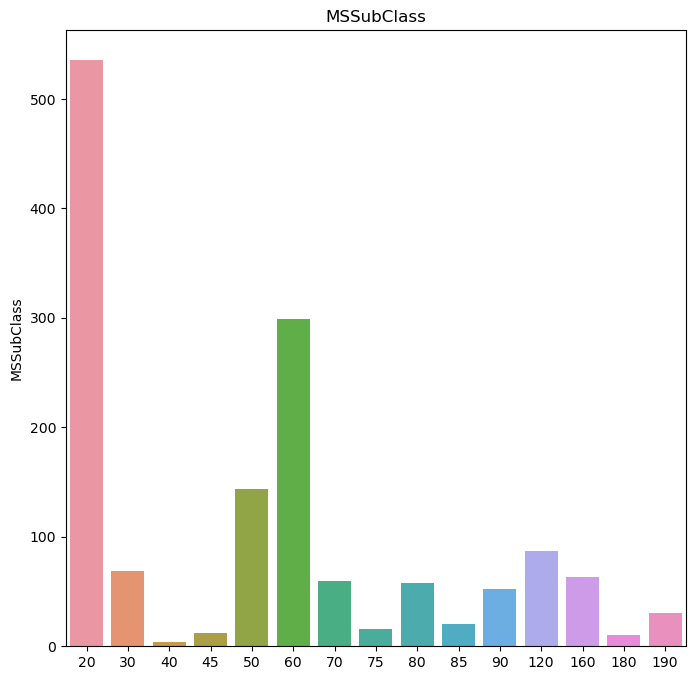

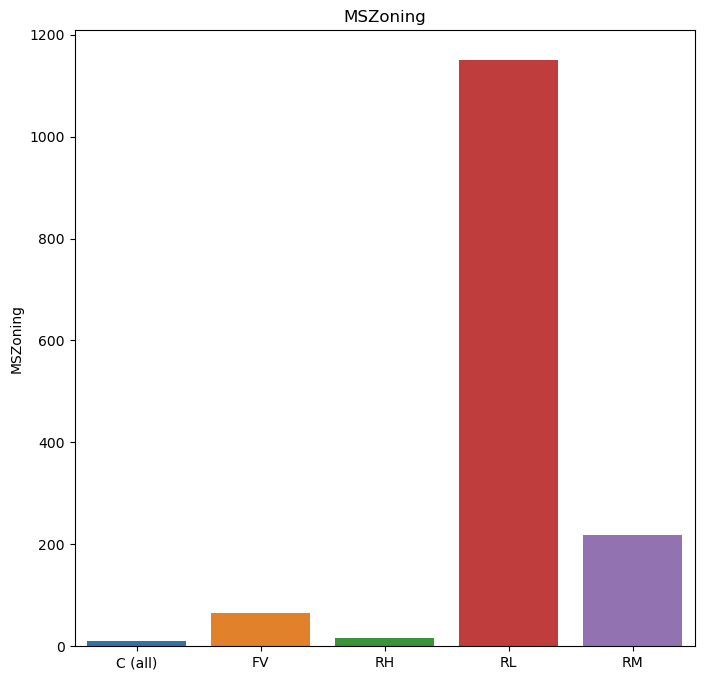

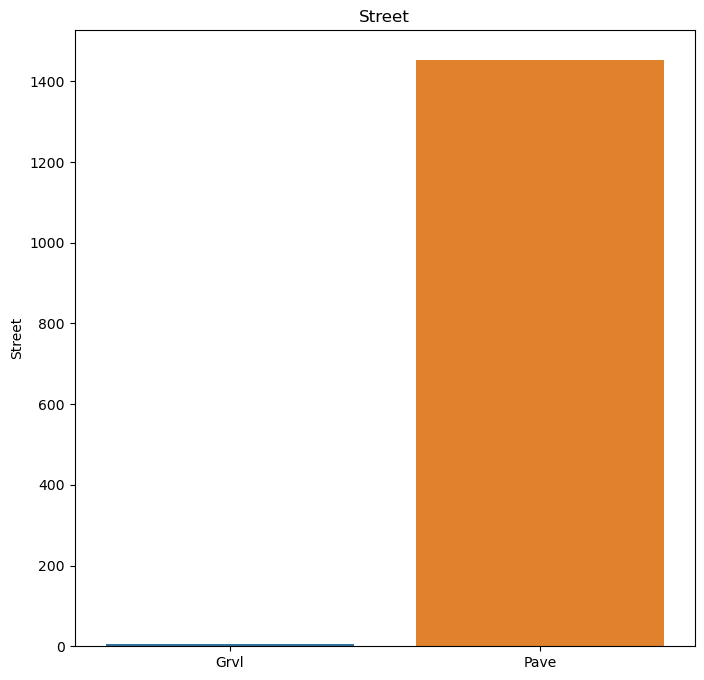

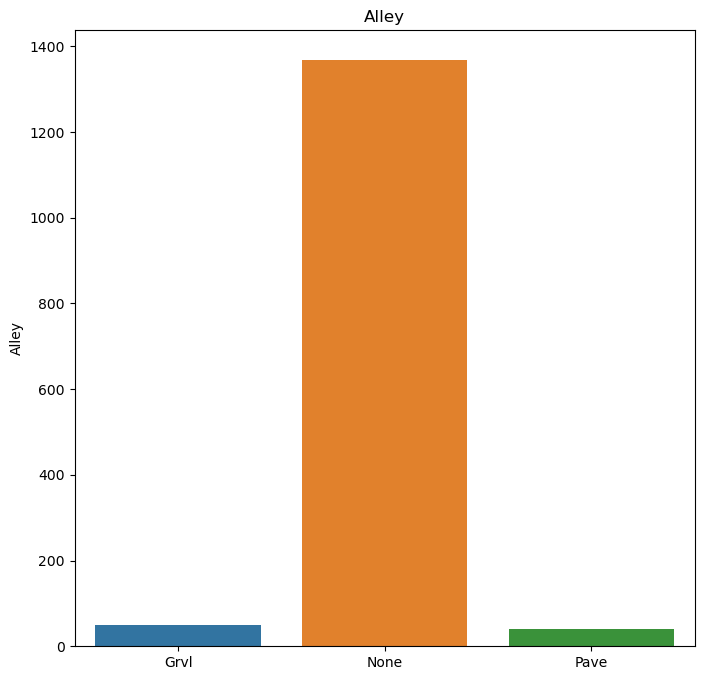

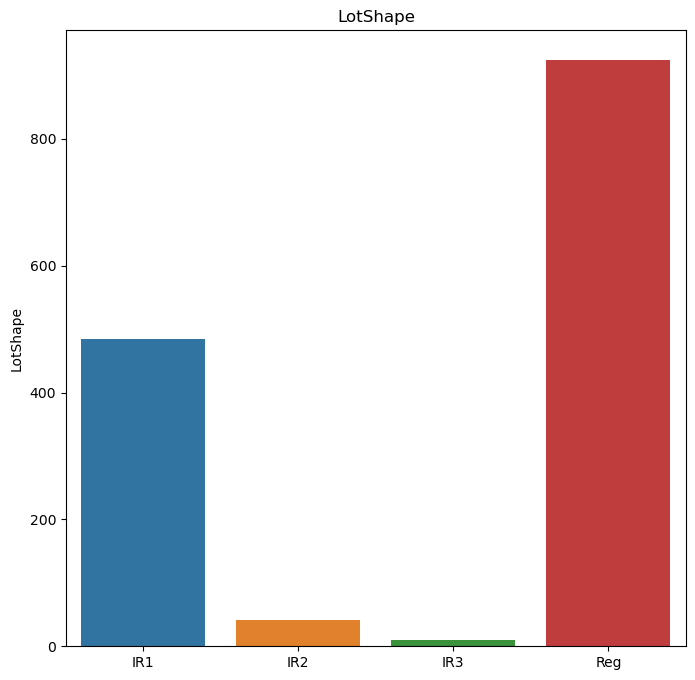

...

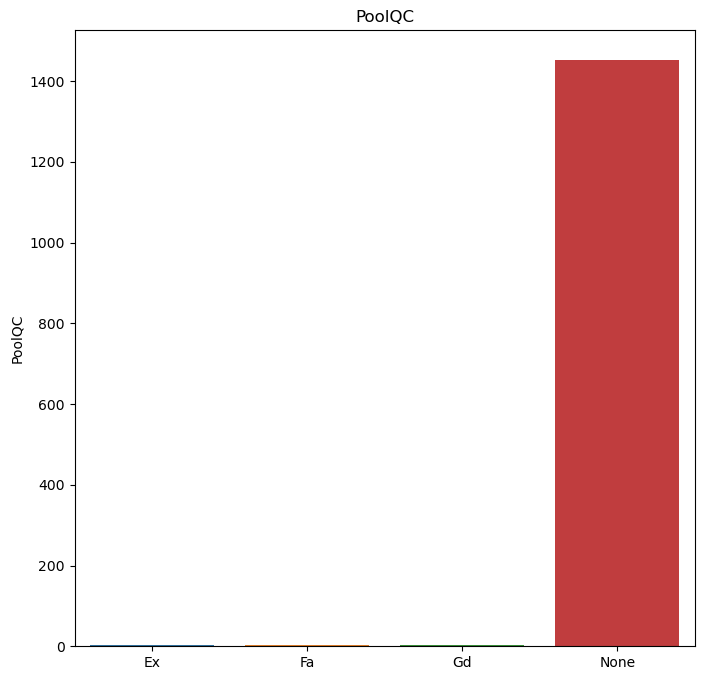

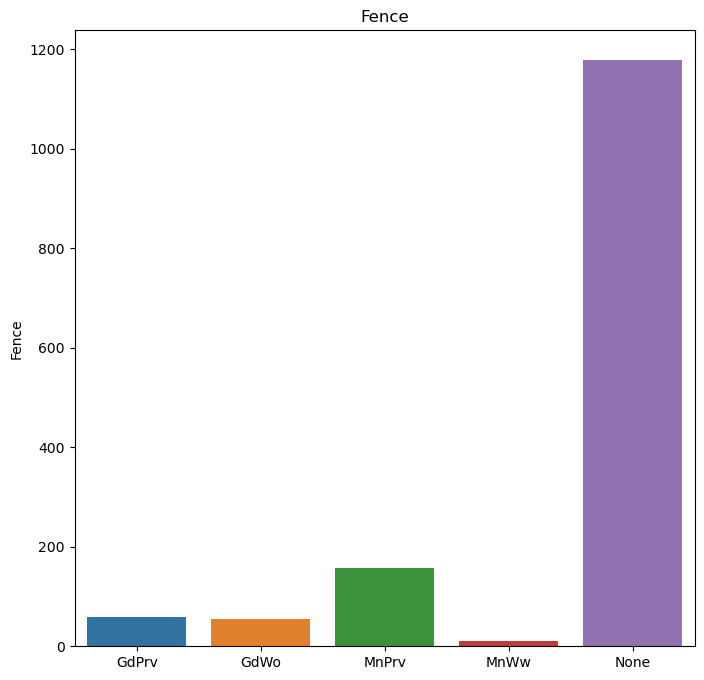

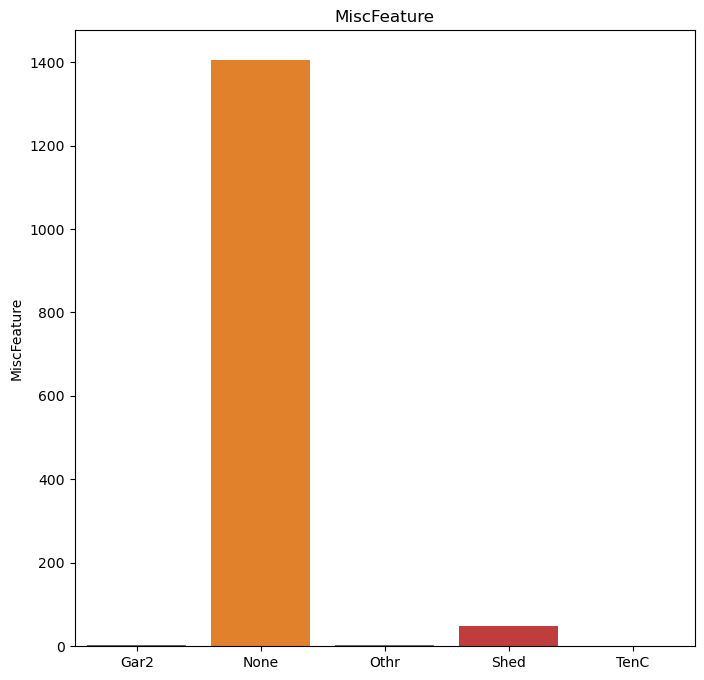

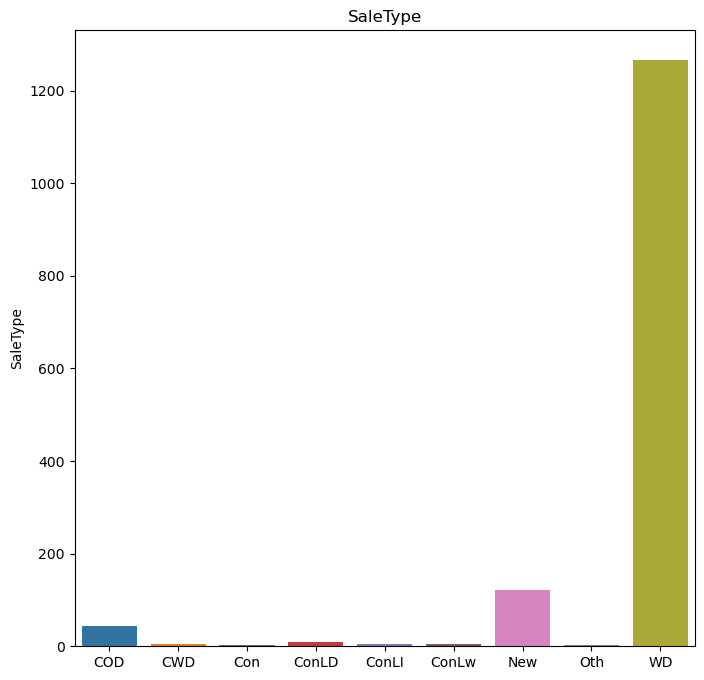

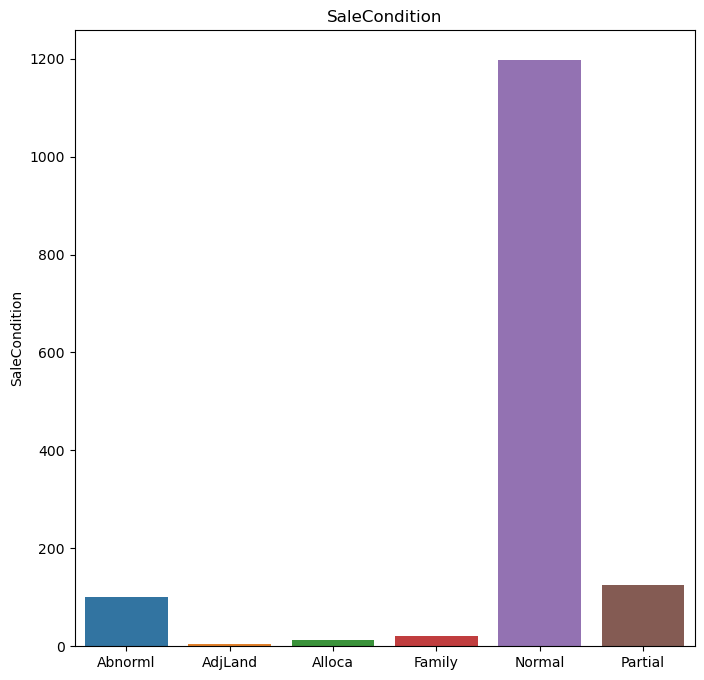

In [33]:
# Let's explore the Variables visually to see any patterns
# Visualizing Category Columns 
for col in cat_column:
    plt.figure(figsize=(8,8))
    plt.title(col)
    sns.barplot(df[col].value_counts().index, df[col].value_counts())
    plt.show()

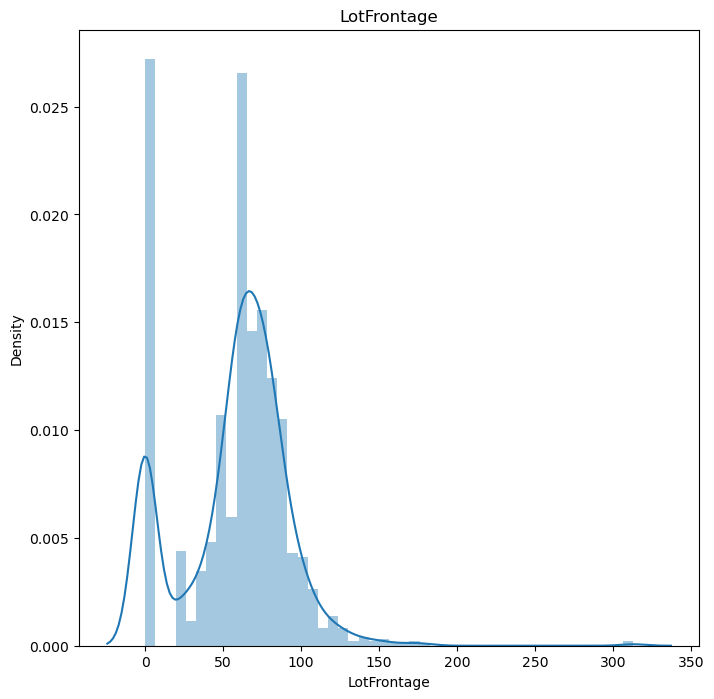

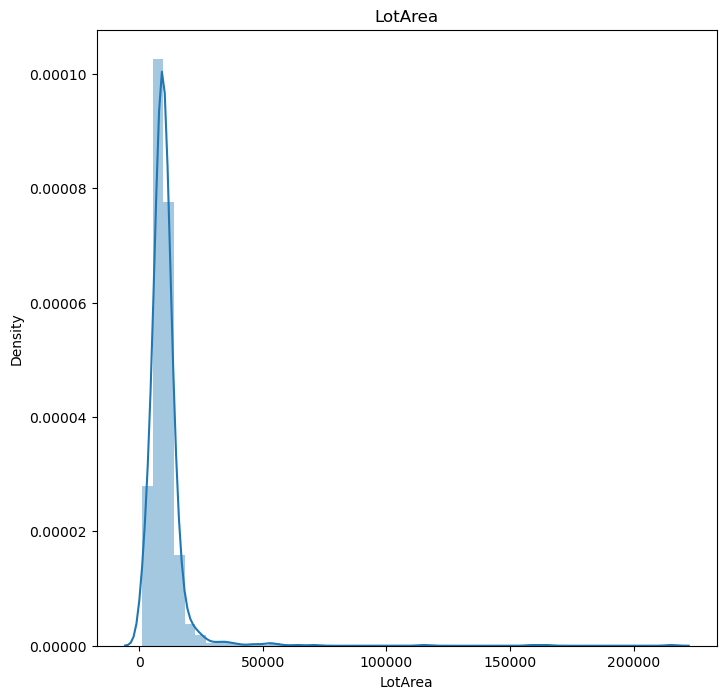

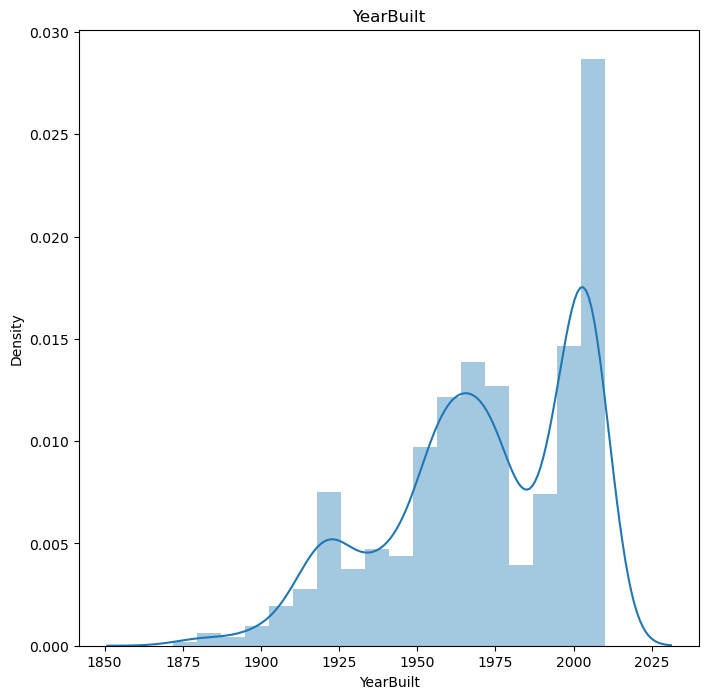

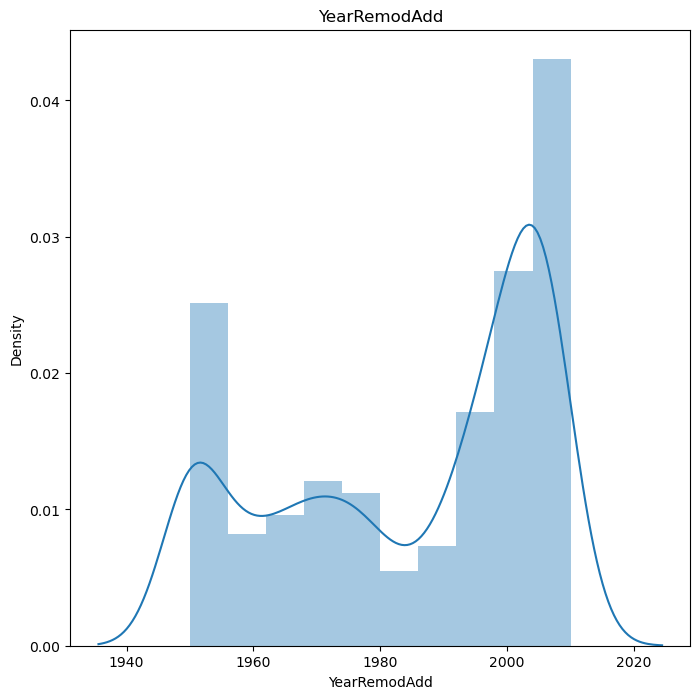

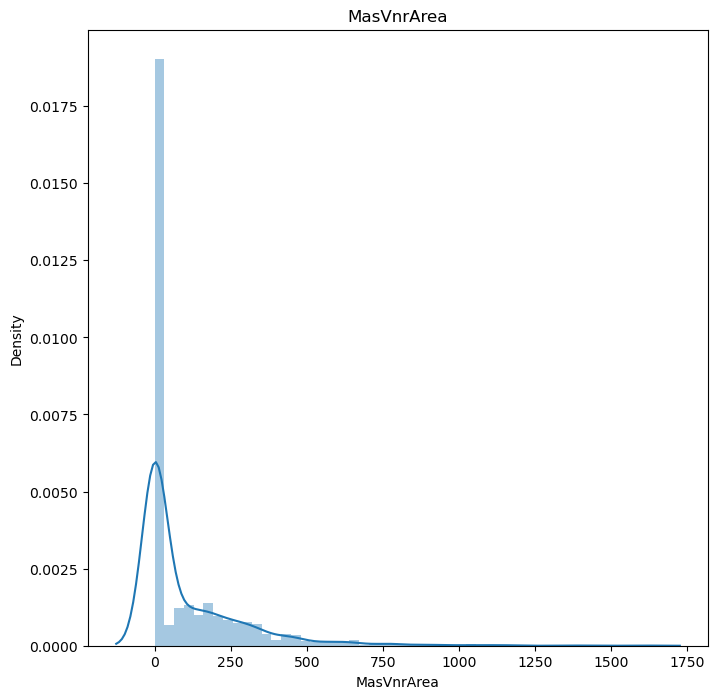

...

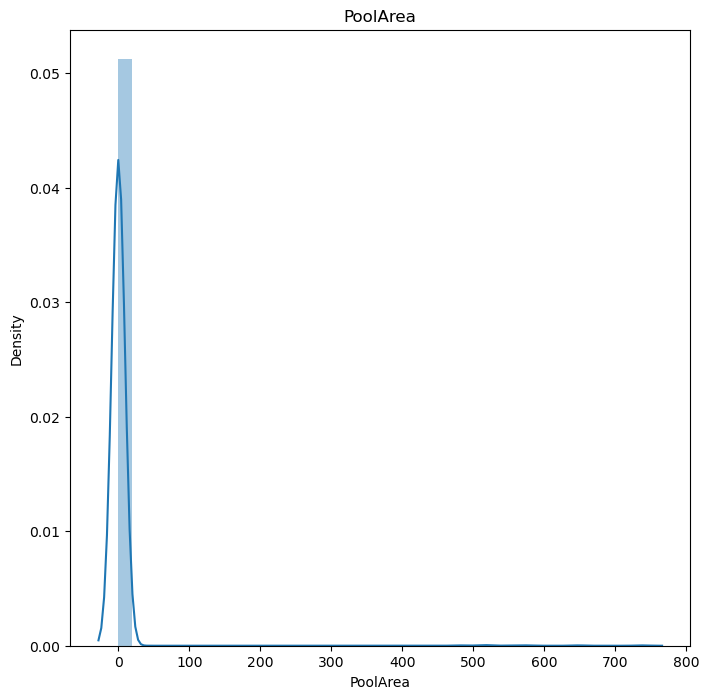

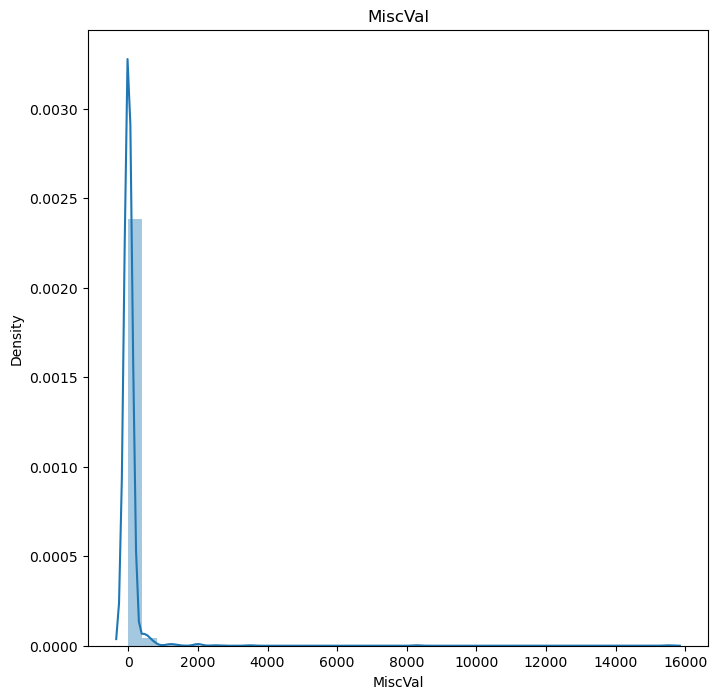

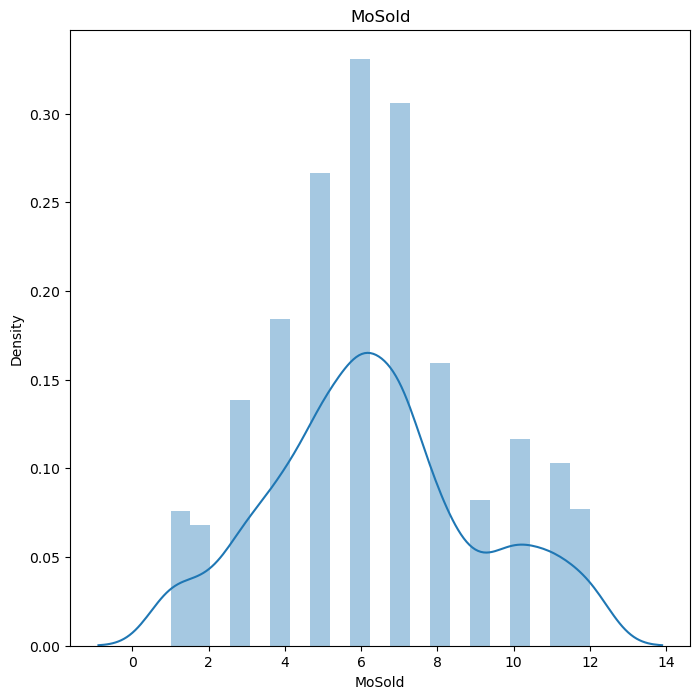

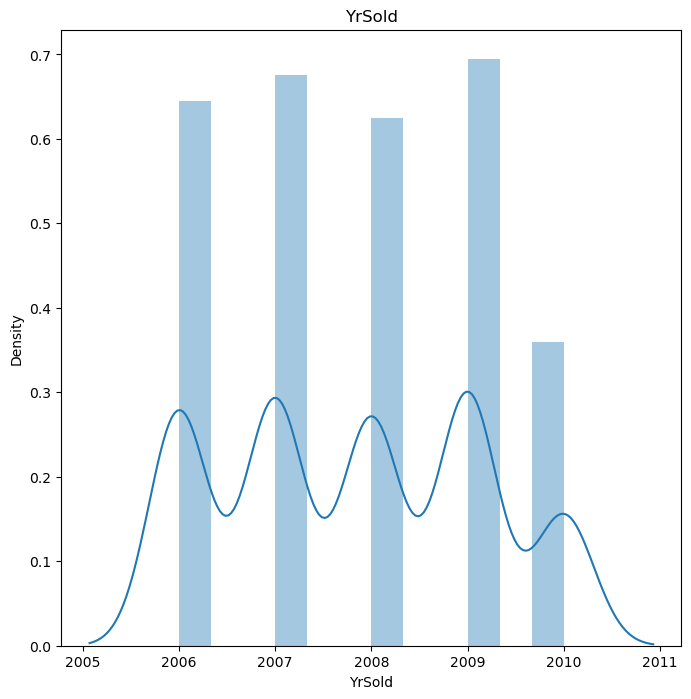

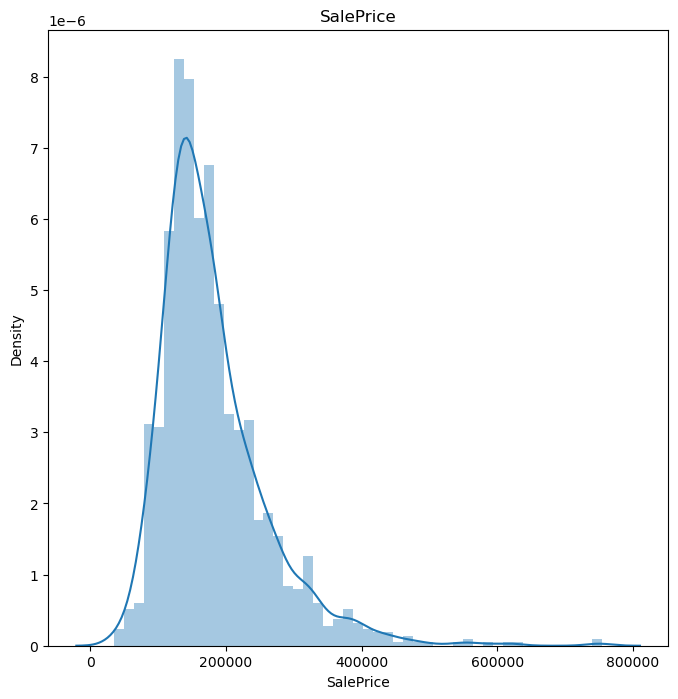

In [34]:
# Visualizing the Numerical Columns through distplot
for col in num_col:
    plt.figure(figsize=(8,8))
    plt.title(col)
    sns.distplot(df[col])
    plt.show()


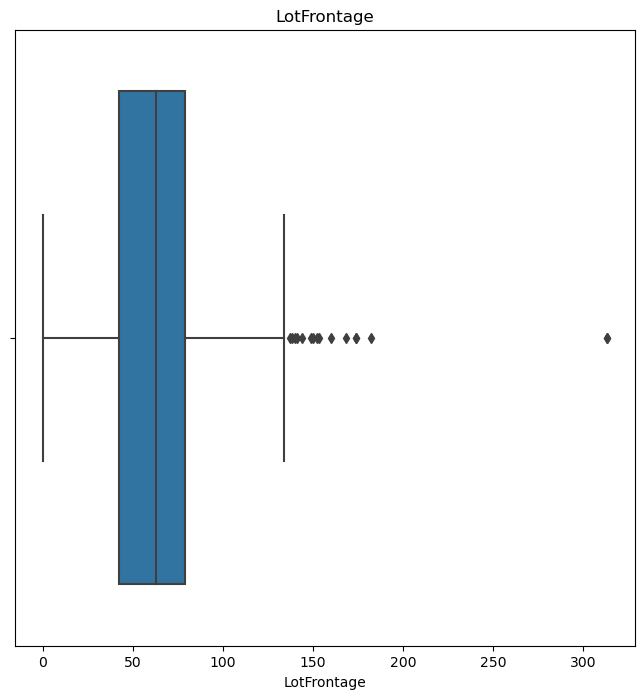

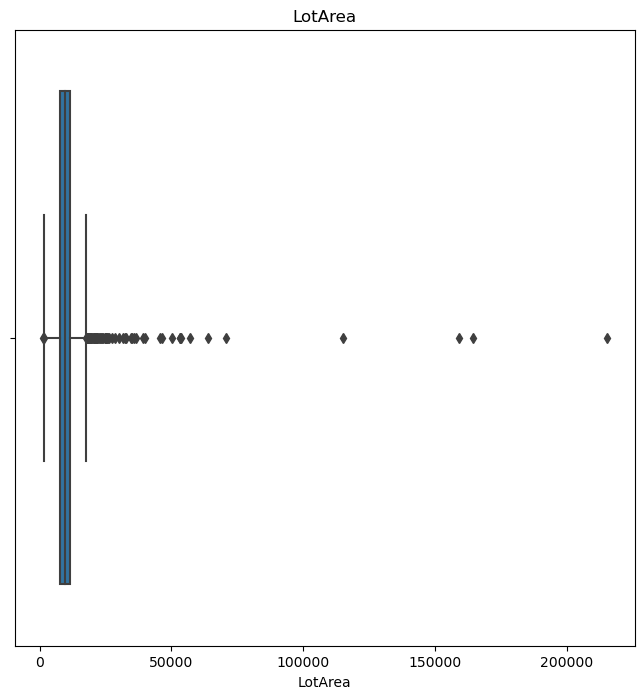

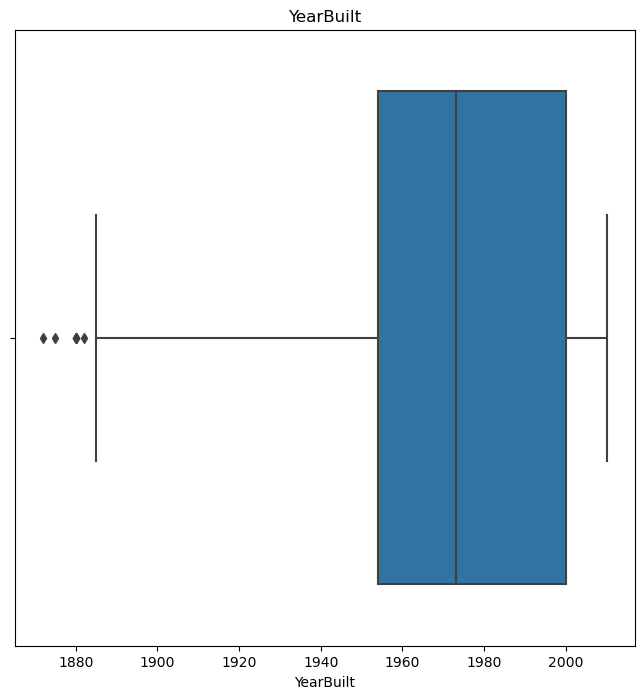

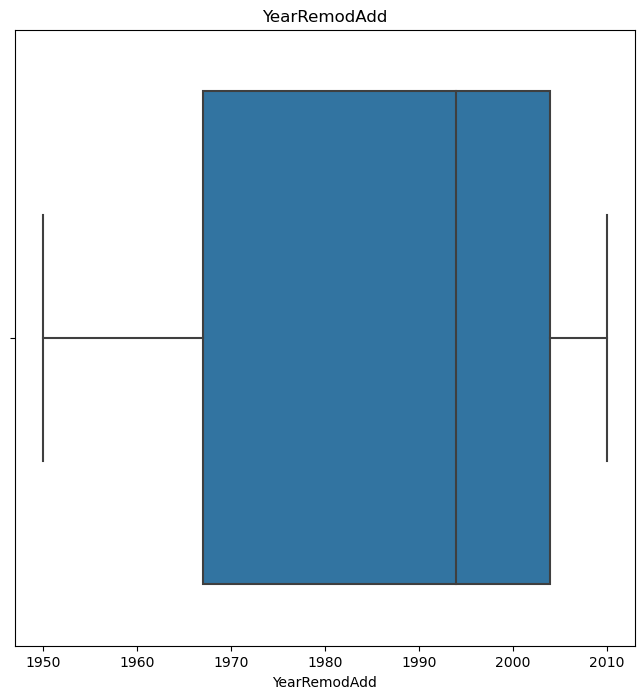

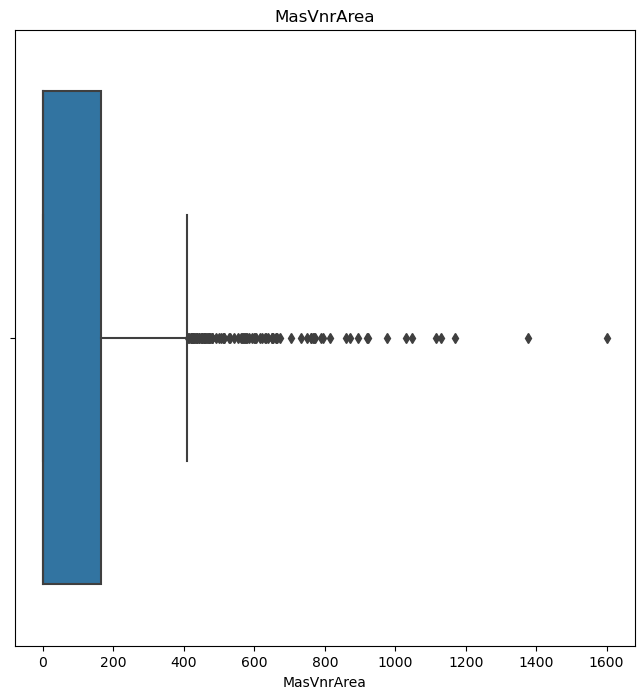

...

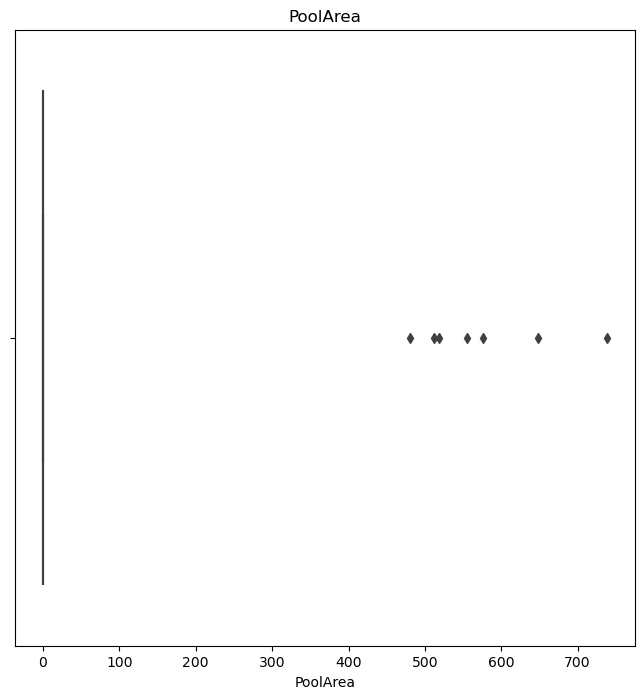

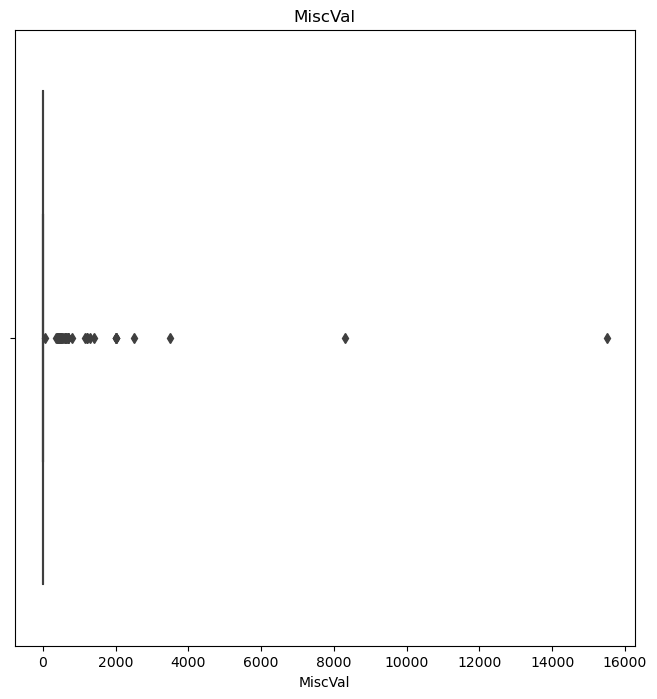

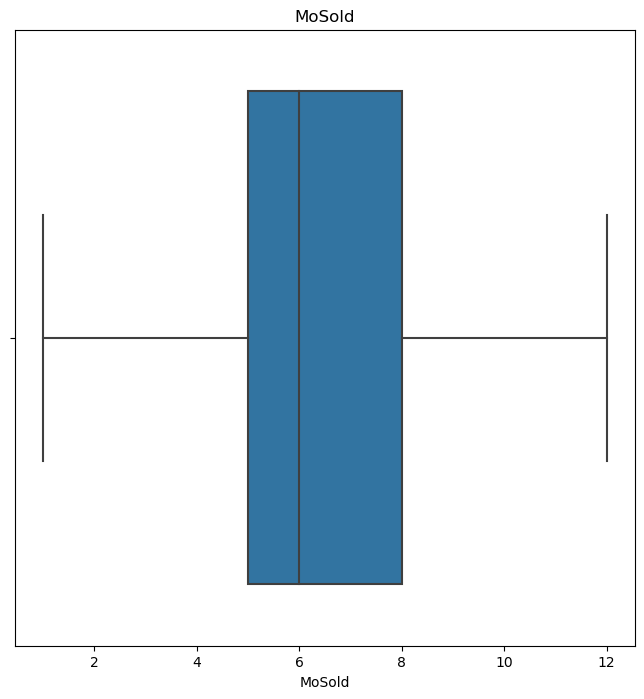

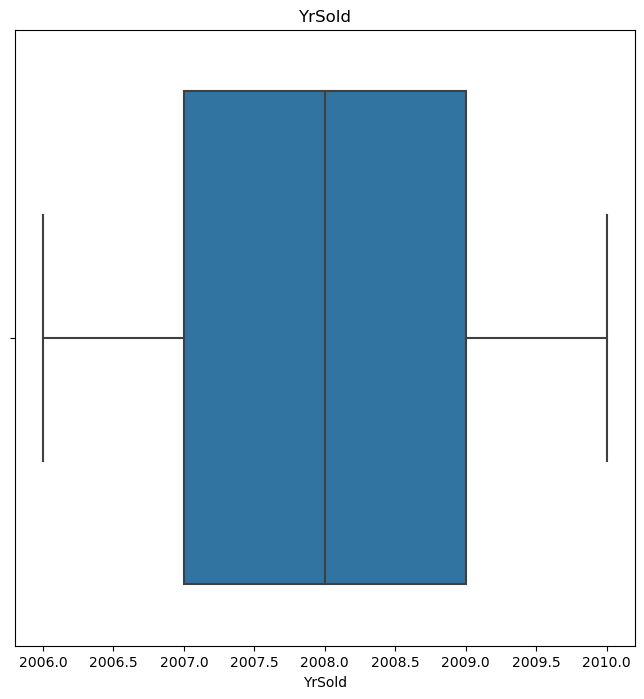

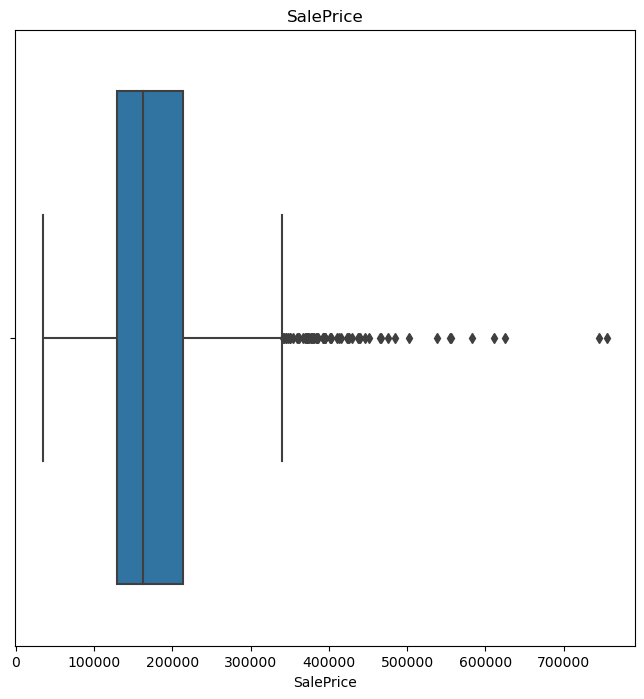

In [35]:
# Visualizing the Numerical Columns through BoxPlot
for col in num_col:
    plt.figure(figsize=(8,8))
    plt.title(col)
    sns.boxplot(df[col])
    plt.show()


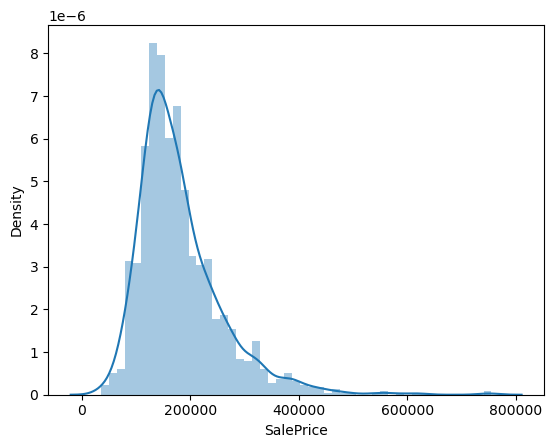

In [36]:
# Let's Visualize the target column SalePrice to see the pattern
plt.figure()
sns.distplot(df['SalePrice'])
plt.show()

In [37]:
# The above graph for SalePrice appears to be left-skewed as the tail towards the right is longer than left
# Let's apply log transformation to SalePrice and visualize it
df['SalePrice'] = np.log1p(df['SalePrice'])


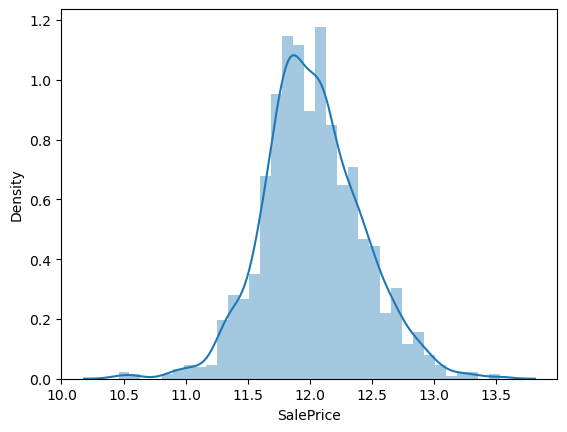

In [38]:
plt.figure()
sns.distplot(df['SalePrice'])
plt.show()

#### Bi-Variate Analysis

In [39]:
sns.pairplot(df, diag_kind='kde')  
plt.show()

In [40]:
len(num_col)


34

In [41]:
print(num_col)

Index(['LotFrontage', 'LotArea', 'YearBuilt', 'YearRemodAdd', 'MasVnrArea',
       'BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', '1stFlrSF',
       '2ndFlrSF', 'LowQualFinSF', 'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath',
       'FullBath', 'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'TotRmsAbvGrd',
       'Fireplaces', 'GarageYrBlt', 'GarageCars', 'GarageArea', 'WoodDeckSF',
       'OpenPorchSF', 'EnclosedPorch', '3SsnPorch', 'ScreenPorch', 'PoolArea',
       'MiscVal', 'MoSold', 'YrSold', 'SalePrice'],
      dtype='object')


<Figure size 1200x800 with 0 Axes>

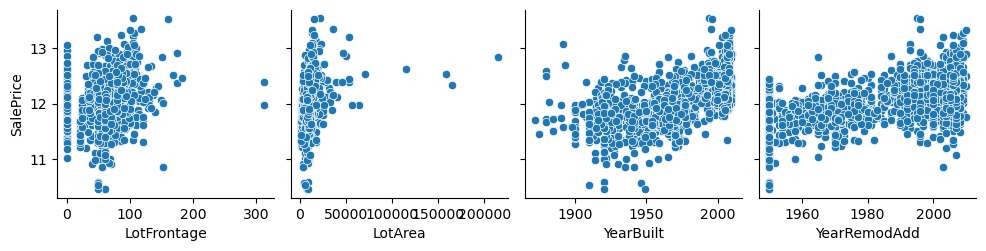

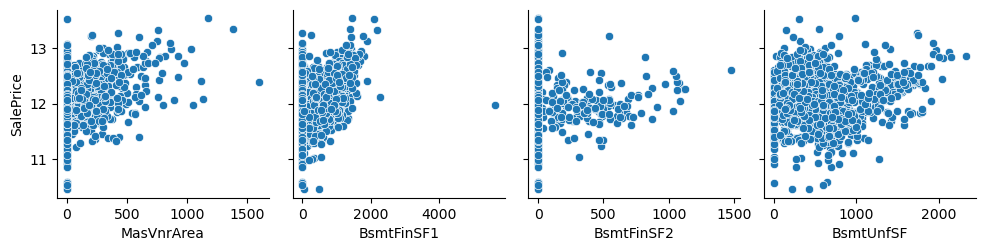

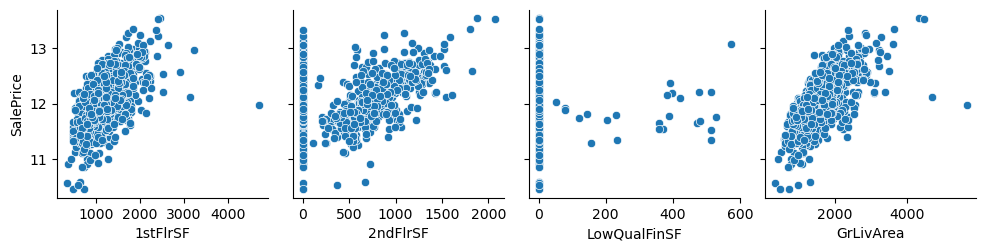

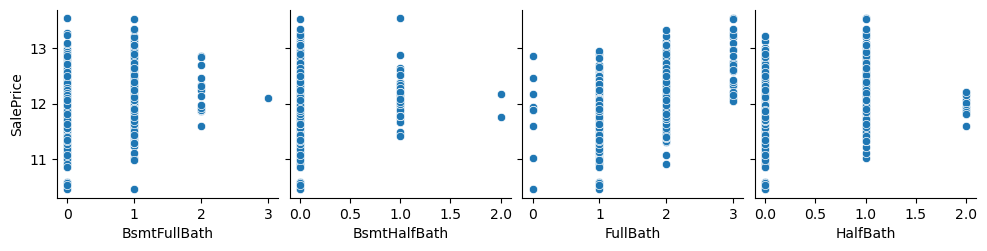

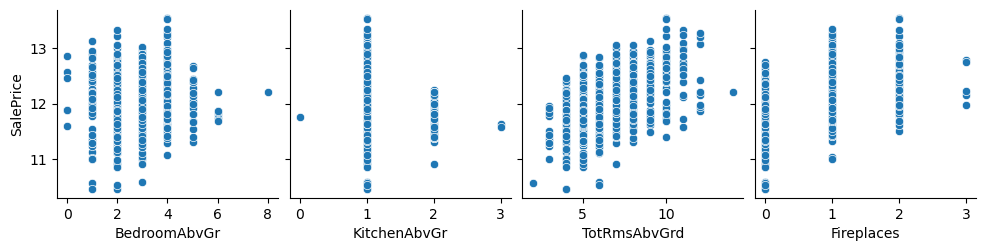

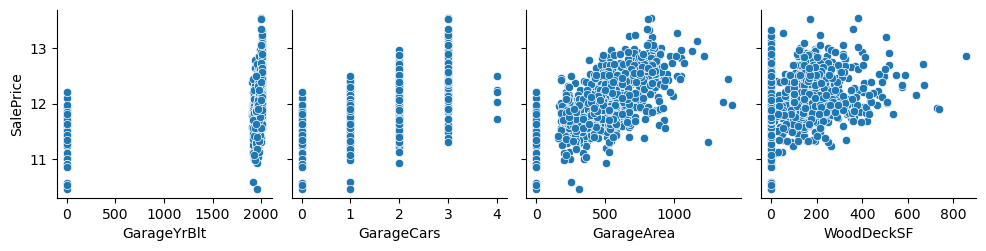

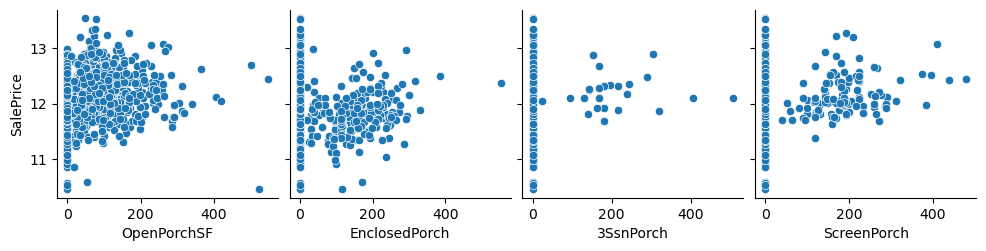

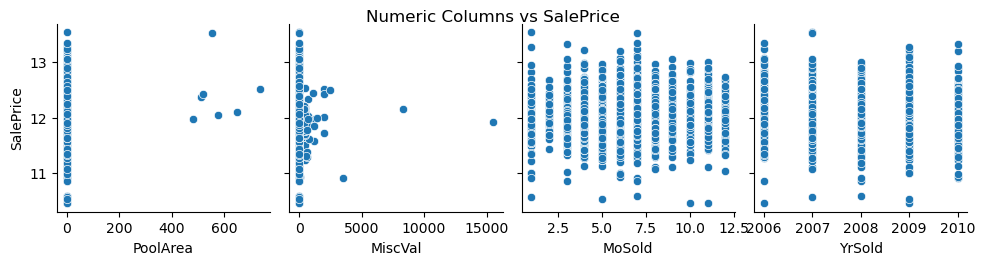

In [42]:
plt.figure(figsize=(12,8))

sns.pairplot(df, x_vars=['LotFrontage', 'LotArea', 'YearBuilt', 'YearRemodAdd'], y_vars=['SalePrice'])
sns.pairplot(df, x_vars=['MasVnrArea','BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF'], y_vars=['SalePrice'])
sns.pairplot(df, x_vars=['1stFlrSF','2ndFlrSF', 'LowQualFinSF', 'GrLivArea'], y_vars=['SalePrice'])
sns.pairplot(df, x_vars=['BsmtFullBath', 'BsmtHalfBath','FullBath', 'HalfBath'], y_vars=['SalePrice'])
sns.pairplot(df, x_vars=['BedroomAbvGr', 'KitchenAbvGr', 'TotRmsAbvGrd','Fireplaces'], y_vars=['SalePrice'])
sns.pairplot(df, x_vars=['GarageYrBlt', 'GarageCars', 'GarageArea', 'WoodDeckSF'], y_vars=['SalePrice'])
sns.pairplot(df, x_vars=['OpenPorchSF', 'EnclosedPorch', '3SsnPorch', 'ScreenPorch'], y_vars=['SalePrice'])
sns.pairplot(df, x_vars=['PoolArea','MiscVal', 'MoSold', 'YrSold'], y_vars=['SalePrice'])
plt.suptitle('Numeric Columns vs SalePrice', y=1.02)

plt.show()

### Heat Map and Correlation matrix

In [43]:
corr = df.corr()
corr

,LotFrontage,LotArea,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
LotFrontage,1.000000,0.100739,0.036853,0.078686,0.105010,0.076670,-0.009312,0.160829,0.238274,0.245181,0.042549,0.049981,0.220347,0.010514,-0.027856,0.120548,-0.012952,0.144494,0.034425,0.221396,0.044018,0.019317,0.165229,0.201473,-0.016780,0.069605,0.027366,0.023499,0.022969,0.114106,-0.059606,0.018942,-0.012094,0.179303
LotArea,0.100739,1.000000,0.014228,0.013788,0.103321,0.214103,0.111170,-0.002618,0.260833,0.299475,0.050986,0.004779,0.263116,0.158155,0.048046,0.126031,0.014259,0.119690,-0.017784,0.190015,0.271364,0.072599,0.154871,0.180403,0.171698,0.084774,-0.018340,0.020423,0.043160,0.077672,0.038068,0.001205,-0.014261,0.257320
YearBuilt,0.036853,0.014228,1.000000,0.592855,0.311600,0.249503,-0.049107,0.149040,0.391452,0.281986,0.010308,-0.183784,0.199010,0.187599,-0.038162,0.468271,0.242656,-0.070651,-0.174800,0.095589,0.147716,0.272029,0.537850,0.478954,0.224880,0.188686,-0.387268,0.031355,-0.050364,0.004950,-0.034383,0.012398,-0.013618,0.586570
YearRemodAdd,0.078686,0.013788,0.592855,1.000000,0.176529,0.128451,-0.067759,0.181133,0.291066,0.240379,0.140024,-0.062419,0.287389,0.119470,-0.012337,0.439046,0.183331,-0.040581,-0.149598,0.191740,0.112581,0.146357,0.420622,0.371600,0.205726,0.226298,-0.193919,0.045286,-0.038740,0.005829,-0.010286,0.021490,0.035743,0.565608
MasVnrArea,0.105010,0.103321,0.311600,0.176529,1.000000,0.261256,-0.071330,0.113862,0.360067,0.339850,0.173800,-0.068628,0.388052,0.083010,0.027403,0.272999,0.199108,0.102775,-0.038450,0.279568,0.247015,0.132696,0.361945,0.370884,0.159991,0.122528,-0.109907,0.019144,0.062248,0.011928,-0.029512,-0.006723,-0.008317,0.426776
BsmtFinSF1,0.076670,0.214103,0.249503,0.128451,0.261256,1.000000,-0.050117,-0.495251,0.522396,0.445863,-0.137079,-0.064503,0.208171,0.649212,0.067418,0.058543,0.004262,-0.107355,-0.081007,0.044316,0.260011,0.115843,0.224054,0.296970,0.204306,0.111761,-0.102303,0.026451,0.062021,0.140491,0.003571,-0.015727,0.014359,0.372023
BsmtFinSF2,-0.009312,0.111170,-0.049107,-0.067759,-0.071330,-0.050117,1.000000,-0.209294,0.104810,0.097117,-0.099260,0.014807,-0.009640,0.158678,0.070948,-0.076444,-0.032148,-0.015728,-0.040751,-0.035227,0.046921,0.035070,-0.038264,-0.018227,0.067898,0.003093,0.036543,-0.029993,0.088871,0.041709,0.004940,-0.015211,0.031706,0.004832
BsmtUnfSF,0.160829,-0.002618,0.149040,0.181133,0.113862,-0.495251,-0.209294,1.000000,0.415360,0.317987,0.004469,0.028167,0.240257,-0.422900,-0.095804,0.288886,-0.041118,0.166643,0.030086,0.250647,0.051575,0.042720,0.214175,0.183303,-0.005316,0.129005,-0.002538,0.020764,-0.012579,-0.035092,-0.023837,0.034888,-0.041258,0.221985
TotalBsmtSF,0.238274,0.260833,0.391452,0.291066,0.360067,0.522396,0.104810,0.415360,1.000000,0.819530,-0.174512,-0.033245,0.454868,0.307351,-0.000315,0.323722,-0.048804,0.050450,-0.068901,0.285573,0.339519,0.176359,0.434585,0.486665,0.232019,0.247264,-0.095478,0.037384,0.084489,0.126053,-0.018479,0.013196,-0.014969,0.612134
1stFlrSF,0.245181,0.299475,0.281986,0.240379,0.339850,0.445863,0.097117,0.317987,0.819530,1.000000,-0.202646,-0.014241,0.566024,0.244671,0.001956,0.380637,-0.119916,0.127401,0.068101,0.409516,0.410531,0.166642,0.439317,0.489782,0.235459,0.211671,-0.065292,0.056104,0.088758,0.131525,-0.021096,0.031372,-0.013604,0.596981


<AxesSubplot:>

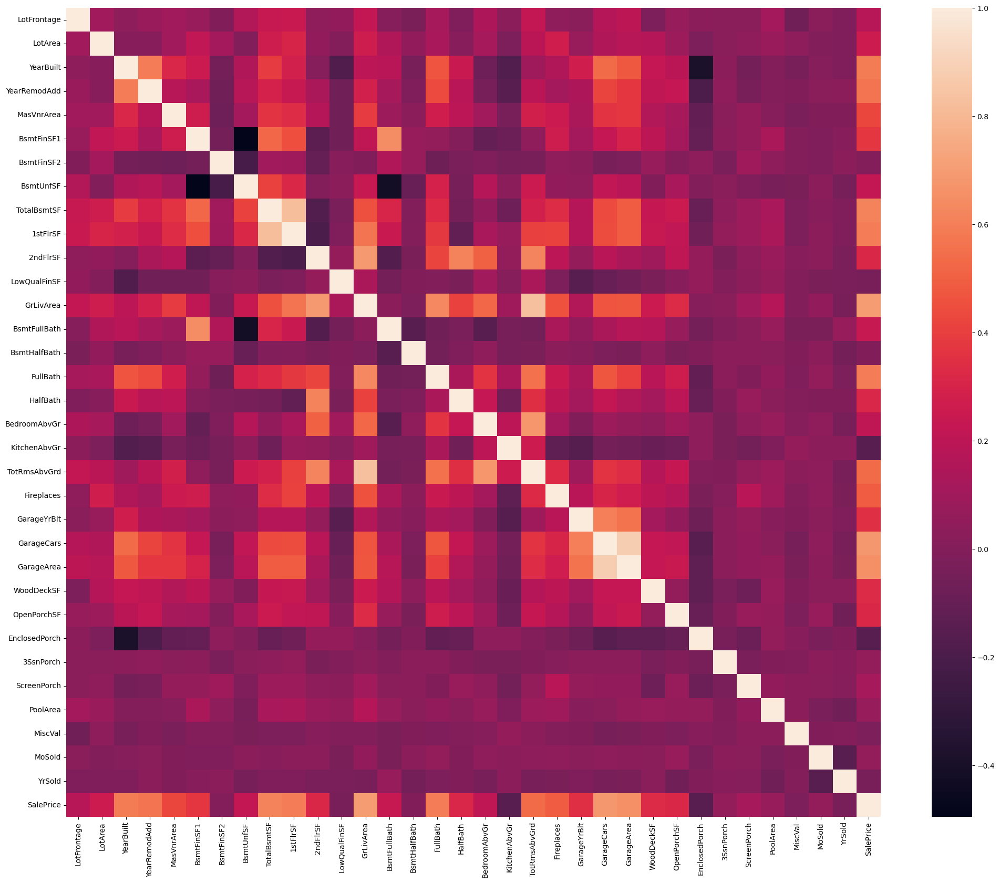

In [44]:
plt.figure(figsize=(25,20))

sns.heatmap(corr)

In [45]:
# Getting the pairs with high correaltion
pairs = [(corr.columns[i], corr.columns[j])
         for i in range(len(corr.columns))
         for j in range(i + 1, len(corr.columns))
         if 0.8 < abs(corr.iloc[i, j]) < 1]
pairs

[('TotalBsmtSF', '1stFlrSF'),
 ('GrLivArea', 'TotRmsAbvGrd'),
 ('GarageCars', 'GarageArea')]

In [47]:
# Correlation for SalePrice
saleprice_correlations = corr['SalePrice'].sort_values(ascending=False)
print(saleprice_correlations)


SalePrice        1.000000
GrLivArea        0.700927
GarageCars       0.680625
GarageArea       0.650888
TotalBsmtSF      0.612134
1stFlrSF         0.596981
FullBath         0.594771
YearBuilt        0.586570
YearRemodAdd     0.565608
TotRmsAbvGrd     0.534422
Fireplaces       0.489450
MasVnrArea       0.426776
BsmtFinSF1       0.372023
GarageYrBlt      0.349013
WoodDeckSF       0.334135
OpenPorchSF      0.321053
2ndFlrSF         0.319300
HalfBath         0.313982
LotArea          0.257320
BsmtFullBath     0.236224
BsmtUnfSF        0.221985
BedroomAbvGr     0.209043
LotFrontage      0.179303
ScreenPorch      0.121208
PoolArea         0.069798
MoSold           0.057330
3SsnPorch        0.054900
BsmtFinSF2       0.004832
BsmtHalfBath    -0.005149
MiscVal         -0.020021
YrSold          -0.037263
LowQualFinSF    -0.037963
KitchenAbvGr    -0.147548
EnclosedPorch   -0.149050
Name: SalePrice, dtype: float64


GrLivArea, GarageCars, GarageArea and TotalBsmtSF have better correlation with SalePrice(>0.6)

### Creating Dummies for the Categorical Columns

In [48]:
#Dummy Creation 
dummy_df = pd.get_dummies(df[cat_column], prefix=cat_column, drop_first=True)
dummy_df.head()

,MSSubClass_30,MSSubClass_40,MSSubClass_45,MSSubClass_50,MSSubClass_60,MSSubClass_70,MSSubClass_75,MSSubClass_80,MSSubClass_85,MSSubClass_90,MSSubClass_120,MSSubClass_160,MSSubClass_180,MSSubClass_190,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,Street_Pave,Alley_None,Alley_Pave,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,Utilities_NoSeWa,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,LandSlope_Mod,LandSlope_Sev,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,Condition1_Feedr,Condition1_Norm,Condition1_PosA,Condition1_PosN,Condition1_RRAe,Condition1_RRAn,Condition1_RRNe,Condition1_RRNn,Condition2_Feedr,Condition2_Norm,Condition2_PosA,Condition2_PosN,Condition2_RRAe,Condition2_RRAn,Condition2_RRNn,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,OverallQual_2,OverallQual_3,OverallQual_4,OverallQual_5,OverallQual_6,OverallQual_7,OverallQual_8,OverallQual_9,OverallQual_10,OverallCond_2,OverallCond_3,OverallCond_4,OverallCond_5,OverallCond_6,OverallCond_7,OverallCond_8,OverallCond_9,RoofStyle_Gable,RoofStyle_Gambrel,RoofStyle_Hip,RoofStyle_Mansard,RoofStyle_Shed,RoofMatl_CompShg,RoofMatl_Membran,RoofMatl_Metal,RoofMatl_Roll,RoofMatl_Tar&Grv,RoofMatl_WdShake,RoofMatl_WdShngl,Exterior1st_AsphShn,Exterior1st_BrkComm,Exterior1st_BrkFace,Exterior1st_CBlock,Exterior1st_CemntBd,Exterior1st_HdBoard,Exterior1st_ImStucc,Exterior1st_MetalSd,Exterior1st_Plywood,Exterior1st_Stone,Exterior1st_Stucco,Exterior1st_VinylSd,Exterior1st_Wd Sdng,Exterior1st_WdShing,Exterior2nd_AsphShn,Exterior2nd_Brk Cmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_Wd Sdng,Exterior2nd_Wd Shng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,ExterCond_Fa,ExterCond_Gd,ExterCond_Po,ExterCond_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_None,BsmtQual_TA,BsmtCond_Gd,BsmtCond_None,BsmtCond_Po,BsmtCond_TA,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtExposure_None,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_None,BsmtFinType1_Rec,BsmtFinType1_Unf,BsmtFinType2_BLQ,BsmtFinType2_GLQ,BsmtFinType2_LwQ,BsmtFinType2_None,BsmtFinType2_Rec,BsmtFinType2_Unf,Heating_GasA,Heating_GasW,Heating_Grav,Heating_OthW,Heating_Wall,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,CentralAir_Y,Electrical_FuseF,Electrical_FuseP,Electrical_Mix,Electrical_None,Electrical_SBrkr,KitchenQual_Fa,KitchenQual_Gd,KitchenQual_TA,Functional_Maj2,Functional_Min1,Functional_Min2,Functional_Mod,Functional_Sev,Functional_Typ,FireplaceQu_Fa,FireplaceQu_Gd,FireplaceQu_None,FireplaceQu_Po,FireplaceQu_TA,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageType_None,GarageFinish_None,GarageFinish_RFn,GarageFinish_Unf,GarageQual_Fa,GarageQual_Gd,GarageQual_None,GarageQual_Po,GarageQual_TA,GarageCond_Fa,GarageCond_Gd,GarageCond_None,GarageCond_Po,GarageCond_TA,PavedDrive_P,PavedDrive_Y,PoolQC_Fa,PoolQC_Gd,PoolQC_None,Fence_GdWo,Fence_MnPrv,Fence_MnWw,Fence_None,MiscFeature_None,MiscFeature_Othr,MiscFeature_Shed,MiscFeature_TenC,SaleType_CWD,SaleType_Con,SaleType_ConLD,SaleType_ConLI,SaleType_ConLw,SaleType_New,SaleType

In [49]:
data = pd.concat([df, dummy_df], axis=1)
data.head()

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice,MSSubClass_30,MSSubClass_40,MSSubClass_45,MSSubClass_50,MSSubClass_60,MSSubClass_70,MSSubClass_75,MSSubClass_80,MSSubClass_85,MSSubClass_90,MSSubClass_120,MSSubClass_160,MSSubClass_180,MSSubClass_190,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,Street_Pave,Alley_None,Alley_Pave,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,Utilities_NoSeWa,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,LandSlope_Mod,LandSlope_Sev,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,Condition1_Feedr,Condition1_Norm,Condition1_PosA,Condition1_PosN,Condition1_RRAe,Condition1_RRAn,Condition1_RRNe,Condition1_RRNn,Condition2_Feedr,Condition2_Norm,Condition2_PosA,Condition2_PosN,Condition2_RRAe,Condition2_RRAn,Condition2_RRNn,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,OverallQual_2,OverallQual_3,OverallQual_4,OverallQual_5,OverallQual_6,OverallQual_7,OverallQual_8,OverallQual_9,OverallQual_10,OverallCond_2,OverallCond_3,OverallCond_4,OverallCond_5,OverallCond_6,OverallCond_7,OverallCond_8,OverallCond_9,RoofStyle_Gable,RoofStyle_Gambrel,RoofStyle_Hip,RoofStyle_Mansard,RoofStyle_Shed,RoofMatl_CompShg,RoofMatl_Membran,RoofMatl_Metal,RoofMatl_Roll,RoofMatl_Tar&Grv,RoofMatl_WdShake,RoofMatl_WdShngl,Exterior1st_AsphShn,Exterior1st_BrkComm,Exterior1st_BrkFace,Exterior1st_CBlock,Exterior1st_CemntBd,Exterior1st_HdBoard,Exterior1st_ImStucc,Exterior1st_MetalSd,Exterior1st_Plywood,Exterior1st_Stone,Exterior1st_Stucco,Exterior1st_VinylSd,Exterior1st_Wd Sdng,Exterior1st_WdShing,Exterior2nd_AsphShn,Exterior2nd_Brk Cmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_Wd Sdng,Exterior2nd_Wd Shng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,ExterCond_Fa,ExterCond_Gd,ExterCond_Po,ExterCond_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_None,BsmtQual_TA,BsmtCond_Gd,BsmtCond_None,BsmtCond_Po,BsmtCond_TA,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtExposure_None,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_None,BsmtFinType1_Rec,BsmtFinType1_Unf,BsmtFinType2_BLQ,BsmtFinType2_GLQ,BsmtFinType2_LwQ,BsmtFinType2_None,BsmtFinType2_Rec,BsmtFinType2_Unf,Heating_GasA,Heating_GasW,Heating_Grav,Heating_OthW,Heating_Wall,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,CentralAir_Y,Electrical_Fu

In [50]:
# Dropping the main categorical columns as we already created dummies for them from data df

data = data.drop(cat_column, axis=1)
data.head()

,LotFrontage,LotArea,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice,MSSubClass_30,MSSubClass_40,MSSubClass_45,MSSubClass_50,MSSubClass_60,MSSubClass_70,MSSubClass_75,MSSubClass_80,MSSubClass_85,MSSubClass_90,MSSubClass_120,MSSubClass_160,MSSubClass_180,MSSubClass_190,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,Street_Pave,Alley_None,Alley_Pave,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,Utilities_NoSeWa,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,LandSlope_Mod,LandSlope_Sev,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,Condition1_Feedr,Condition1_Norm,Condition1_PosA,Condition1_PosN,Condition1_RRAe,Condition1_RRAn,Condition1_RRNe,Condition1_RRNn,Condition2_Feedr,Condition2_Norm,Condition2_PosA,Condition2_PosN,Condition2_RRAe,Condition2_RRAn,Condition2_RRNn,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,OverallQual_2,OverallQual_3,OverallQual_4,OverallQual_5,OverallQual_6,OverallQual_7,OverallQual_8,OverallQual_9,OverallQual_10,OverallCond_2,OverallCond_3,OverallCond_4,OverallCond_5,OverallCond_6,OverallCond_7,OverallCond_8,OverallCond_9,RoofStyle_Gable,RoofStyle_Gambrel,RoofStyle_Hip,RoofStyle_Mansard,RoofStyle_Shed,RoofMatl_CompShg,RoofMatl_Membran,RoofMatl_Metal,RoofMatl_Roll,RoofMatl_Tar&Grv,RoofMatl_WdShake,RoofMatl_WdShngl,Exterior1st_AsphShn,Exterior1st_BrkComm,Exterior1st_BrkFace,Exterior1st_CBlock,Exterior1st_CemntBd,Exterior1st_HdBoard,Exterior1st_ImStucc,Exterior1st_MetalSd,Exterior1st_Plywood,Exterior1st_Stone,Exterior1st_Stucco,Exterior1st_VinylSd,Exterior1st_Wd Sdng,Exterior1st_WdShing,Exterior2nd_AsphShn,Exterior2nd_Brk Cmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_Wd Sdng,Exterior2nd_Wd Shng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,ExterCond_Fa,ExterCond_Gd,ExterCond_Po,ExterCond_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_None,BsmtQual_TA,BsmtCond_Gd,BsmtCond_None,BsmtCond_Po,BsmtCond_TA,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtExposure_None,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_None,BsmtFinType1_Rec,BsmtFinType1_Unf,BsmtFinType2_BLQ,BsmtFinType2_GLQ,BsmtFinType2_LwQ,BsmtFinType2_None,BsmtFinType2_Rec,BsmtFinType2_Unf,Heating_GasA,Heating_GasW,Heating_Grav,Heating_OthW,Heating_Wall,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,CentralAir_Y,Electrical_FuseF,Electrical_FuseP,Electrical_Mix,Electrical_None,Electrical_SBrkr,KitchenQual_Fa,KitchenQual_Gd,KitchenQual_TA,Functional_Maj2,Functional_Min1,Functional_Min2,Functional_Mod,Functional_Sev,Functional_Typ,FireplaceQu_Fa,FireplaceQu_Gd,FireplaceQu_None,FireplaceQu_Po,FireplaceQu_TA,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageType_None,GarageFinish_None,GarageFinish_RFn,GarageFinish_Unf,GarageQual_Fa,GarageQual_Gd,GarageQual_N

## 4. Model Building

### Train-Test Split

In [51]:
# Train Test Split
# Creating X, y
X = data.drop('SalePrice', axis=1)
y = data['SalePrice']
X

,LotFrontage,LotArea,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,MSSubClass_30,MSSubClass_40,MSSubClass_45,MSSubClass_50,MSSubClass_60,MSSubClass_70,MSSubClass_75,MSSubClass_80,MSSubClass_85,MSSubClass_90,MSSubClass_120,MSSubClass_160,MSSubClass_180,MSSubClass_190,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,Street_Pave,Alley_None,Alley_Pave,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,Utilities_NoSeWa,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,LandSlope_Mod,LandSlope_Sev,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,Condition1_Feedr,Condition1_Norm,Condition1_PosA,Condition1_PosN,Condition1_RRAe,Condition1_RRAn,Condition1_RRNe,Condition1_RRNn,Condition2_Feedr,Condition2_Norm,Condition2_PosA,Condition2_PosN,Condition2_RRAe,Condition2_RRAn,Condition2_RRNn,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,OverallQual_2,OverallQual_3,OverallQual_4,OverallQual_5,OverallQual_6,OverallQual_7,OverallQual_8,OverallQual_9,OverallQual_10,OverallCond_2,OverallCond_3,OverallCond_4,OverallCond_5,OverallCond_6,OverallCond_7,OverallCond_8,OverallCond_9,RoofStyle_Gable,RoofStyle_Gambrel,RoofStyle_Hip,RoofStyle_Mansard,RoofStyle_Shed,RoofMatl_CompShg,RoofMatl_Membran,RoofMatl_Metal,RoofMatl_Roll,RoofMatl_Tar&Grv,RoofMatl_WdShake,RoofMatl_WdShngl,Exterior1st_AsphShn,Exterior1st_BrkComm,Exterior1st_BrkFace,Exterior1st_CBlock,Exterior1st_CemntBd,Exterior1st_HdBoard,Exterior1st_ImStucc,Exterior1st_MetalSd,Exterior1st_Plywood,Exterior1st_Stone,Exterior1st_Stucco,Exterior1st_VinylSd,Exterior1st_Wd Sdng,Exterior1st_WdShing,Exterior2nd_AsphShn,Exterior2nd_Brk Cmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_Wd Sdng,Exterior2nd_Wd Shng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,ExterCond_Fa,ExterCond_Gd,ExterCond_Po,ExterCond_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_None,BsmtQual_TA,BsmtCond_Gd,BsmtCond_None,BsmtCond_Po,BsmtCond_TA,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtExposure_None,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_None,BsmtFinType1_Rec,BsmtFinType1_Unf,BsmtFinType2_BLQ,BsmtFinType2_GLQ,BsmtFinType2_LwQ,BsmtFinType2_None,BsmtFinType2_Rec,BsmtFinType2_Unf,Heating_GasA,Heating_GasW,Heating_Grav,Heating_OthW,Heating_Wall,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,CentralAir_Y,Electrical_FuseF,Electrical_FuseP,Electrical_Mix,Electrical_None,Electrical_SBrkr,KitchenQual_Fa,KitchenQual_Gd,KitchenQual_TA,Functional_Maj2,Functional_Min1,Functional_Min2,Functional_Mod,Functional_Sev,Functional_Typ,FireplaceQu_Fa,FireplaceQu_Gd,FireplaceQu_None,FireplaceQu_Po,FireplaceQu_TA,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageType_None,GarageFinish_None,GarageFinish_RFn,GarageFinish_Unf,GarageQual_Fa,GarageQual_Gd,GarageQual_None,Garage

In [52]:
y

0       12.247699
1       12.109016
2       12.317171
3       11.849405
4       12.429220
5       11.870607
6       12.634606
7       12.206078
8       11.774528
9       11.678448
10      11.771444
11      12.751303
12      11.877576
13      12.540761
14      11.964007
15      11.790565
16      11.911708
17      11.407576
18      11.976666
19      11.842236
20      12.692506
21      11.845110
22      12.345839
23      11.774528
24      11.944714
25      12.454108
26      11.811555
27      12.631344
28      12.242891
29      11.134604
30      10.596660
31      11.914055
32      12.100162
33      12.016733
34      12.533580
35      12.641100
36      11.884496
37      11.938200
38      11.599112
39      11.314487
40      11.982935
41      12.043560
42      11.877576
43      11.777219
44      11.856522
45      12.675767
46      12.387089
47      12.428019
48      11.635152
49      11.751950
50      12.083911
51      11.648339
52      11.608245
53      12.861001
54      11.775297
55      12

In [53]:
#Splitting the data as 70% for Train and 30% for Test
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=0.7, test_size=0.3, random_state=100)


In [54]:
# Scaling the numeric columns

# Create a MinMaxScaler
scaler = MinMaxScaler()

# Fit and transform the training data
X_train = scaler.fit_transform(X_train)

# Transform the test data using the same scaler
X_test = scaler.transform(X_test)

### First Model without Ridge/Lasso

In [55]:
# Model Building - without Ridge/Lasso, Let's see how our model looks initially with plain linear regression

reg = LinearRegression()
reg.fit(X_train,y_train)

LinearRegression()

In [56]:
# Get the coefficients
coefficients = reg.coef_

# Print the coefficients
print("Coefficients:", coefficients)

Coefficients: [-1.01303279e-02  7.28859297e-01  2.95356126e-01  6.91715119e-02
  2.54372041e-02  1.53789776e+10  4.01640910e+09  6.36521821e+09
 -1.66487514e+10  9.14421586e+10  4.37101985e+10  1.09010907e+10
 -1.10153934e+11  5.70919514e-02 -9.98377800e-04  5.23934364e-02
  1.58300065e-02  4.43971157e-02 -1.93952978e-01 -5.88655472e-03
 -5.72466850e-03  5.54561615e-02  9.59274769e-02  1.35406911e-01
  6.32350445e-02  3.95099521e-02  5.53709567e-02  7.72397518e-02
  5.87174892e-02  4.65930223e-01 -3.32067490e-01  3.11815739e-03
 -9.87625122e-03 -8.53282362e-02 -2.02615023e-01 -2.31562495e-01
 -1.37360096e-02 -3.88131142e-02  6.95501268e-03 -1.39849424e-01
 -4.41319346e-02  1.04098320e-02 -1.92757578e+09 -1.26991272e-02
 -1.30889863e-01 -4.78444397e-02  3.99170477e+09  4.86459613e-01
  4.56847727e-01  4.62047100e-01  3.97737980e-01  1.04106426e-01
  2.58732438e-02  5.29515147e-02  1.40114427e-02  1.76819563e-02
  1.03988647e-02 -3.76701355e-03 -2.08215714e-02  1.62035227e-02
 -1.2503572

In [57]:
reg.intercept_

120173523673.50444

In [58]:
# Lets predict for X_train & X_test
y_pred_train = reg.predict(X_train)
y_pred_test = reg.predict(X_test)

In [59]:
# Calculate R2 score, RSS and RMSE

# Evaluate training performance
mse_train = mean_squared_error(y_train, y_pred_train)
r2_train = r2_score(y_train, y_pred_train)
rmse_train = np.sqrt(mse_train)

print("For Training Set:-")
print("MSE:", mse_train)
print("R^2:", r2_train)
print("Root Mean Squared Error (RMSE):", rmse_train)

# Evaluate test performance
mse_test = mean_squared_error(y_test, y_pred_test)
r2_test = r2_score(y_test, y_pred_test)
rmse_test = np.sqrt(mse_test)
print()
print("For Test Set:-")
print("MSE:", mse_test)
print("R^2:", r2_test)
print("Root Mean Squared Error (RMSE):", rmse_test)


For Training Set:-
MSE: 0.005801461538056176
R^2: 0.9630924951192089
Root Mean Squared Error (RMSE): 0.07616732592165866

For Test Set:-
MSE: 3.1432498027247247e+19
R^2: -1.9103498148786278e+20
Root Mean Squared Error (RMSE): 5606469301.373837


#### Inference:
The model seems to perform well on the training set,but there are signs of severe overfitting or other issues when applied to the test set.
Let's apply the Ridge/Lasso regularization 

### Ridge Regularization

In [61]:
# Let's find the best Alpha for our Ridge regularization techniques

#Defining the Alpha values to search
params = {'alpha': [0.0001, 0.001, 0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0,
                    2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 20, 50, 100, 500, 1000]}

#Initializing Ridge Regression Model
ridge = Ridge()

# cross validation

ridgeCV = GridSearchCV(estimator = ridge, 
                        param_grid = params, 
                        scoring= 'neg_mean_absolute_error',  
                        cv = 5, 
                        return_train_score=True,
                        verbose = 1, n_jobs=-1)            
ridgeCV.fit(X_train, y_train) 

Fitting 5 folds for each of 28 candidates, totalling 140 fits


GridSearchCV(cv=5, estimator=Ridge(), n_jobs=-1,
             param_grid={'alpha': [0.0001, 0.001, 0.01, 0.05, 0.1, 0.2, 0.3,
                                   0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 2.0, 3.0,
                                   4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 20, 50,
                                   100, 500, 1000]},
             return_train_score=True, scoring='neg_mean_absolute_error',
             verbose=1)

In [62]:
# Get the best hyperparameter
best_alpha = ridgeCV.best_params_['alpha']
print("Best Alpha:", best_alpha)

Best Alpha: 0.1


In [63]:
best_score = ridgeCV.best_score_
print("Best Score:", best_score)

Best Score: -0.09018428314951939


In [64]:
ridgeCV.cv_results_

{'mean_fit_time': array([0.02513103, 0.01737981, 0.01115255, 0.01886897, 0.01070161,
        0.00790515, 0.00896559, 0.01036158, 0.00945358, 0.01342964,
        0.01110892, 0.0101264 , 0.0115674 , 0.01269855, 0.00740299,
        0.01120329, 0.00955319, 0.01107359, 0.01043005, 0.00681553,
        0.013587  , 0.01285872, 0.01073318, 0.01070876, 0.00927224,
        0.00855474, 0.01119442, 0.00990295]),
 'std_fit_time': array([0.00629057, 0.00550429, 0.00332621, 0.00906231, 0.00702693,
        0.00197412, 0.00240383, 0.00297284, 0.00255587, 0.00650268,
        0.00480759, 0.00346839, 0.00622028, 0.00445529, 0.00130669,
        0.00569952, 0.00565411, 0.00559718, 0.0061031 , 0.00143642,
        0.00710116, 0.00245226, 0.0057869 , 0.00415044, 0.00301152,
        0.0026138 , 0.00374405, 0.00233659]),
 'mean_score_time': array([0.00074959, 0.000458  , 0.00051885, 0.00047021, 0.00032969,
        0.00040946, 0.00035224, 0.00035505, 0.00032802, 0.00086064,
        0.00128441, 0.00032463, 0.000566

In [65]:
# Let's use the best alpha for our Ridge Regression 

final_ridge_model = Ridge(alpha=best_alpha)
final_ridge_model.fit(X_train, y_train)


Ridge(alpha=0.1)

In [66]:
# Get the coefficients of the final Ridge model
coefficients_ridge = final_ridge_model.coef_
print(coefficients_ridge)

[-2.10780087e-02  5.42526777e-01  2.51791372e-01  6.86314502e-02
  2.43493620e-02  3.44931248e-01  9.05404338e-02  6.23614813e-02
  3.64308508e-01  5.63712372e-01  2.73491904e-01  6.62612780e-03
  5.77135027e-01  7.88468804e-02  4.49236026e-03  7.21027818e-02
  2.20680078e-02  4.93232467e-02 -1.74026620e-01  2.44330901e-02
 -1.06857989e-03 -2.36062993e-02  1.21957435e-01  1.09991992e-01
  6.55943868e-02  3.70787944e-02  5.20812470e-02  8.76982820e-02
  6.05401456e-02  1.16391614e-01  4.38097271e-02  4.28945818e-03
 -1.00346447e-02 -8.83393076e-02 -9.88634208e-02 -2.05367955e-01
 -2.83375066e-03 -4.62933132e-02  1.22749763e-02 -4.85177680e-02
 -3.59366865e-02  1.40757667e-02 -6.64509544e-03 -2.85938208e-02
 -1.32999082e-01 -6.47641182e-02 -2.96220994e-02  4.14545229e-01
  3.92687072e-01  3.99325444e-01  3.45760763e-01  8.39281784e-02
  1.96237111e-02  5.08714057e-02  1.54392969e-02  9.36753342e-03
  9.89007773e-03  8.13870152e-03  5.14929433e-03  2.76785085e-02
 -1.31401858e-01  2.86436

In [67]:
# Predictions on the training set
y_pred_train_ridge = final_ridge_model.predict(X_train)

# Predictions on the test set
y_pred_test_ridge = final_ridge_model.predict(X_test)


In [68]:
# Let's see the performance of our Ridge Model
# R-squared
r2_train_r = r2_score(y_train, y_pred_train_ridge)
r2_test_r = r2_score(y_test, y_pred_test_ridge)

# Mean Squared Error
mse_train_r = mean_squared_error(y_train, y_pred_train_ridge)
mse_test_r = mean_squared_error(y_test, y_pred_test_ridge)

# Root Mean Squared Error
rmse_train_r = np.sqrt(mse_train_r)
rmse_test_r = np.sqrt(mse_test_r)

# Print the Training results
print("Train:-")
print("R-squared (Train):", r2_train_r)
print("Mean Squared Error (Train):", mse_train_r)
print("Root Mean Squared Error (Train):", rmse_train_r)

# Print the Test results
print("\nTest:-")
print("R-squared (Test):", r2_test_r)
print("Mean Squared Error (Test):", mse_test_r)
print("Root Mean Squared Error (Test):", rmse_test_r)

Train:-
R-squared (Train): 0.9614184769300911
Mean Squared Error (Train): 0.006064599134855038
Root Mean Squared Error (Train): 0.07787553617699873

Test:-
R-squared (Test): 0.7551700296768699
Mean Squared Error (Test): 0.040283813463146925
Root Mean Squared Error (Test): 0.20070827950821293


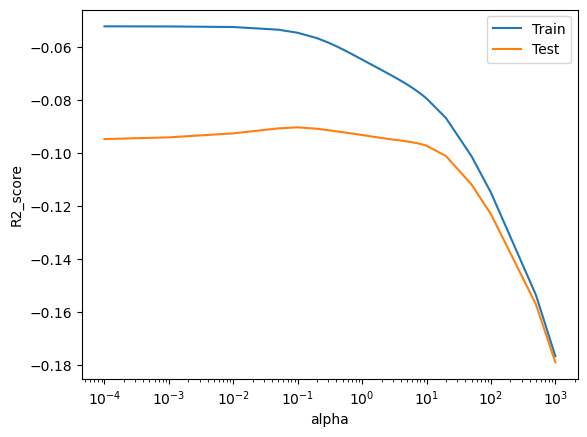

In [69]:
## Create a dataframe of ridge cross validation results
ridgeCV_results= pd.DataFrame(ridgeCV.cv_results_)
ridgeCV_results

## Plotting R2 score vs alpha values
plt.plot(ridgeCV_results['param_alpha'], ridgeCV_results['mean_train_score'], label='Train')
plt.plot(ridgeCV_results['param_alpha'], ridgeCV_results['mean_test_score'], label='Test')
plt.xlabel('alpha')
plt.ylabel('R2_score')
plt.xscale('log')
plt.legend()
plt.show()

We can Infer that As the value of Alpha increase, there's a steep fall in the R2 score for both Test and Train sets and it's clear that the optimum Alpha is 0.1

### Lasso Model

In [70]:
# Let's find the best Alpha for our Ridge regularization techniques

#Defining the Alpha values to search
params = {'alpha': [0.0001, 0.001, 0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0,
                    2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 20, 50, 100, 500, 1000]}

#Initializing Ridge Regression Model
lasso = Lasso()

# Cross-validation
lassoCV = GridSearchCV(estimator=lasso,
                       param_grid=params,
                       scoring='neg_mean_absolute_error',
                       cv=5,
                       return_train_score=True,
                       verbose=1,
                       n_jobs=-1)
lassoCV.fit(X_train, y_train)

Fitting 5 folds for each of 28 candidates, totalling 140 fits


/Users/srinivasareddy/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.611e-02, tolerance: 1.304e-02
  model = cd_fast.enet_coordinate_descent(
/Users/srinivasareddy/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.921e-02, tolerance: 1.314e-02
  model = cd_fast.enet_coordinate_descent(


GridSearchCV(cv=5, estimator=Lasso(), n_jobs=-1,
             param_grid={'alpha': [0.0001, 0.001, 0.01, 0.05, 0.1, 0.2, 0.3,
                                   0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 2.0, 3.0,
                                   4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 20, 50,
                                   100, 500, 1000]},
             return_train_score=True, scoring='neg_mean_absolute_error',
             verbose=1)

In [71]:
best_alpha_L = lassoCV.best_params_
print("Best Alpha for Lasso: ",best_alpha_L)

Best Alpha for Lasso:  {'alpha': 0.0001}


In [72]:
lasso_results = lassoCV.cv_results_
lasso_results

{'mean_fit_time': array([0.20998878, 0.02061963, 0.00697947, 0.00472469, 0.00631366,
        0.00496697, 0.00540447, 0.00456924, 0.0049736 , 0.00260115,
        0.00369477, 0.00381503, 0.00486131, 0.00492945, 0.00544953,
        0.00236096, 0.00545731, 0.00405622, 0.00248375, 0.00449729,
        0.00616117, 0.00218582, 0.00318899, 0.00348177, 0.002953  ,
        0.00363283, 0.00370641, 0.00286098]),
 'std_fit_time': array([0.03747763, 0.00293964, 0.00329205, 0.00188161, 0.00299924,
        0.00355645, 0.00236358, 0.00203259, 0.00348854, 0.00101922,
        0.00231996, 0.00320987, 0.00275075, 0.00311487, 0.0031635 ,
        0.00045713, 0.00307538, 0.00249395, 0.00102064, 0.0016619 ,
        0.00294144, 0.00027986, 0.00136311, 0.00092795, 0.00031117,
        0.00093842, 0.00155262, 0.00040425]),
 'mean_score_time': array([0.00261097, 0.00044212, 0.00064163, 0.0006362 , 0.00273585,
        0.00059118, 0.00067396, 0.00053449, 0.00032806, 0.00029283,
        0.00063324, 0.00044308, 0.000620

In [73]:
#Fitting the Lasso Regression Model for alpha = 0.0001
lasso_M = Lasso(alpha=0.0001)
# Fitting on Training Data
lasso_M.fit(X_train, y_train)

Lasso(alpha=0.0001)

In [74]:
best_score_l = lassoCV.best_score_
print("Best Score:", best_score_l)

Best Score: -0.08379839459948973


In [75]:
# Viewing the co-efficients
lasso_M.coef_

array([ 1.98171278e-03,  4.29549688e-01,  2.39535062e-01,  7.94560687e-02,
        1.68290765e-02,  2.26013292e-01,  3.90718155e-02, -0.00000000e+00,
        5.70232015e-01,  0.00000000e+00,  1.21119966e-03, -6.88605262e-02,
        1.29835556e+00,  8.13513695e-02, -0.00000000e+00,  7.11316126e-02,
        2.54259349e-02,  1.04467458e-02, -1.58729471e-01,  1.71718063e-02,
        4.99977706e-03,  0.00000000e+00,  1.03819576e-01,  1.10639417e-01,
        6.23614074e-02,  4.49424492e-02,  2.46690738e-02,  4.90126883e-02,
        4.69813405e-02,  0.00000000e+00,  0.00000000e+00, -1.88640852e-03,
       -8.02402600e-03, -8.99687704e-02, -7.23007062e-03, -0.00000000e+00,
        8.76074293e-03, -4.91226756e-03,  4.02403057e-02, -0.00000000e+00,
       -0.00000000e+00,  2.34489405e-04, -1.62610322e-03, -1.17529399e-02,
       -6.93575827e-02, -2.23054014e-02, -2.55445008e-02,  3.14593801e-01,
        3.03241683e-01,  3.00965561e-01,  2.51380587e-01,  2.88782256e-02,
        6.05118281e-03,  

In [76]:
# Predicting the data for both the Train and Test set

y_train_pred_l = lasso_M.predict(X_train)
y_test_pred_l = lasso_M.predict(X_test)

In [77]:
# Let's see the performance of our Lasso Model
# R-squared
r2_train_l = r2_score(y_train, y_train_pred_l)
r2_test_l = r2_score(y_test, y_test_pred_l)

# Mean Squared Error
mse_train_l = mean_squared_error(y_train, y_train_pred_l)
mse_test_l = mean_squared_error(y_test, y_test_pred_l)

# Root Mean Squared Error
rmse_train_l = np.sqrt(mse_train_l)
rmse_test_l = np.sqrt(mse_test_l)

# Print the Training results
print("Train:-")
print("R-squared (Train):", r2_train_l)
print("Mean Squared Error (Train):", mse_train_l)
print("Root Mean Squared Error (Train):", rmse_train_l)

# Print the Test results
print("\nTest:-")
print("R-squared (Test):", r2_test_l)
print("Mean Squared Error (Test):", mse_test_l)
print("Root Mean Squared Error (Test):", rmse_test_l)

Train:-
R-squared (Train): 0.9580291624903569
Mean Squared Error (Train): 0.006597362794333152
Root Mean Squared Error (Train): 0.0812241515457881

Test:-
R-squared (Test): 0.6813925840690762
Mean Squared Error (Test): 0.05242300072330667
Root Mean Squared Error (Test): 0.228960696896447


In [78]:
lassoCV.cv_results_

{'mean_fit_time': array([0.20998878, 0.02061963, 0.00697947, 0.00472469, 0.00631366,
        0.00496697, 0.00540447, 0.00456924, 0.0049736 , 0.00260115,
        0.00369477, 0.00381503, 0.00486131, 0.00492945, 0.00544953,
        0.00236096, 0.00545731, 0.00405622, 0.00248375, 0.00449729,
        0.00616117, 0.00218582, 0.00318899, 0.00348177, 0.002953  ,
        0.00363283, 0.00370641, 0.00286098]),
 'std_fit_time': array([0.03747763, 0.00293964, 0.00329205, 0.00188161, 0.00299924,
        0.00355645, 0.00236358, 0.00203259, 0.00348854, 0.00101922,
        0.00231996, 0.00320987, 0.00275075, 0.00311487, 0.0031635 ,
        0.00045713, 0.00307538, 0.00249395, 0.00102064, 0.0016619 ,
        0.00294144, 0.00027986, 0.00136311, 0.00092795, 0.00031117,
        0.00093842, 0.00155262, 0.00040425]),
 'mean_score_time': array([0.00261097, 0.00044212, 0.00064163, 0.0006362 , 0.00273585,
        0.00059118, 0.00067396, 0.00053449, 0.00032806, 0.00029283,
        0.00063324, 0.00044308, 0.000620

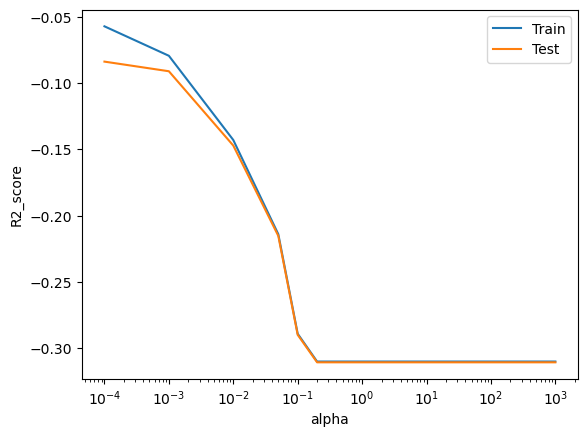

In [79]:
## Create a dataframe of ridge cross validation results
lassoCV_results= pd.DataFrame(lassoCV.cv_results_)
lassoCV_results

## Plotting R2 score vs alpha values
plt.plot(lassoCV_results['param_alpha'], lassoCV_results['mean_train_score'], label='Train')
plt.plot(lassoCV_results['param_alpha'], lassoCV_results['mean_test_score'], label='Test')
plt.xlabel('alpha')
plt.ylabel('R2_score')
plt.xscale('log')
plt.legend()
plt.show()

We can Infer that As the value of Alpha increase, there's a steep fall in the R2 score for both Test and Train sets and it's clear that the optimum Alpha is 0.0001

## 5. Conclusion

### Comparison of Models - Ridge & Lasso

In [80]:
pd.options.display.float_format = "{:,.3f}".format

# creating a Dataframe rl_table with metrics for r2 score,MSE, RMSE for both Ridge and Lasso
rl_table = {
    'Metric': ['R-squared (Train)', 'R-squared (Test)', 'MSE (Train)', 'MSE (Test)', 'RMSE (Train)', 'RMSE (Test)'],
    'Ridge': [r2_train_r, r2_test_r, mse_train_r, mse_test_r, rmse_train_r, rmse_test_r],
    'Lasso': [r2_train_l, r2_test_l, mse_train_l, mse_test_l, rmse_train_l, rmse_test_l]
}

final_metric = pd.DataFrame(rl_table, columns=['Metric', 'Ridge', 'Lasso'])
final_metric.set_index('Metric', inplace=True)

# Display the table
print(final_metric)

                   Ridge  Lasso
Metric                         
R-squared (Train)  0.961  0.958
R-squared (Test)   0.755  0.681
MSE (Train)        0.006  0.007
MSE (Test)         0.040  0.052
RMSE (Train)       0.078  0.081
RMSE (Test)        0.201  0.229


We can infer below, while comparing Ridge and Lasso models
1. R-squared (Train): Both Ridge and Lasso models have a similar performance on the training set, with R-squared values around 0.96.
2. R-squared (Test): Ridge outperforms Lasso on the test set with an R-squared value of 0.76 compared to Lasso's 0.68.
3. MSE (Train): The Mean Squared Error on the training set is low for both models, indicating good fit.
4. MSE (Test): Ridge has a lower Mean Squared Error on the test set (0.04) compared to Lasso (0.05).
5. RMSE (Train): Both models have similar Root Mean Squared Errors on the training set, indicating good fit.
6. RMSE (Test): Ridge has a lower Root Mean Squared Error on the test set (0.20) compared to Lasso (0.23).

In [81]:
#
RL_Betas = pd.DataFrame(index=X.columns)
RL_Betas['Ridge'] = final_ridge_model.coef_
RL_Betas['Lasso'] = lasso_M.coef_

In [82]:
RL_Betas

,Ridge,Lasso
LotFrontage,-0.021,0.002
LotArea,0.543,0.430
YearBuilt,0.252,0.240
YearRemodAdd,0.069,0.079
MasVnrArea,0.024,0.017
BsmtFinSF1,0.345,0.226
BsmtFinSF2,0.091,0.039
BsmtUnfSF,0.062,-0.000
TotalBsmtSF,0.364,0.570
1stFlrSF,0.564,0.000


In [83]:
# Sort the coefficients for Ridge
top_10_ridge = RL_Betas[['Ridge']].sort_values(by='Ridge', ascending=False).head(10)

# Sort the coefficients for Lasso
top_10_lasso = RL_Betas[['Lasso']].sort_values(by='Lasso', ascending=False).head(10)

# Print the results
print("Top 10 Rows for Ridge Coefficients:")
print(top_10_ridge)

print("\nTop 10 Rows for Lasso Coefficients:")
print(top_10_lasso)


Top 10 Rows for Ridge Coefficients:
                  Ridge
GrLivArea         0.577
1stFlrSF          0.564
LotArea           0.543
MSZoning_FV       0.415
MSZoning_RL       0.399
RoofMatl_Membran  0.394
MSZoning_RH       0.393
TotalBsmtSF       0.364
MSZoning_RM       0.346
BsmtFinSF1        0.345

Top 10 Rows for Lasso Coefficients:
               Lasso
GrLivArea      1.298
TotalBsmtSF    0.570
LotArea        0.430
MSZoning_FV    0.315
MSZoning_RH    0.303
MSZoning_RL    0.301
MSZoning_RM    0.251
YearBuilt      0.240
BsmtFinSF1     0.226
OverallQual_9  0.199


In [84]:
# Sort the coefficients for Ridge
last_10_ridge = RL_Betas[['Ridge']].sort_values(by='Ridge', ascending=True).head(10)

# Sort the coefficients for Lasso
last_10_lasso = RL_Betas[['Lasso']].sort_values(by='Lasso', ascending=True).head(10)

# Print the results
print("Last 10 Rows for Ridge Coefficients:")
print(last_10_ridge)

print("\nLast 10 Rows for Lasso Coefficients:")
print(last_10_lasso)


Last 10 Rows for Ridge Coefficients:
                     Ridge
PoolQC_Gd           -1.891
Condition2_PosN     -1.200
Functional_Sev      -0.357
OverallQual_2       -0.309
Condition2_RRAe     -0.277
Exterior1st_BrkComm -0.216
MSSubClass_45       -0.205
KitchenAbvGr        -0.174
HeatingQC_Po        -0.161
OverallCond_3       -0.153

Last 10 Rows for Lasso Coefficients:
                      Lasso
PoolQC_Gd            -2.405
Condition2_PosN      -1.442
OverallQual_2        -0.296
Functional_Sev       -0.204
OverallCond_3        -0.174
KitchenAbvGr         -0.159
Neighborhood_MeadowV -0.149
Exterior1st_BrkComm  -0.130
MSSubClass_30        -0.090
LandSlope_Sev        -0.076


In [85]:
# Columns for which the Lasso Regression have the coefficients as 0
RL_Betas[RL_Betas['Lasso'] == 0]

,Ridge,Lasso
BsmtUnfSF,0.062,-0.000
1stFlrSF,0.564,0.000
BsmtHalfBath,0.004,-0.000
GarageYrBlt,-0.024,0.000
PoolArea,0.116,0.000
MiscVal,0.044,0.000
MSSubClass_45,-0.205,-0.000
MSSubClass_75,-0.049,-0.000
MSSubClass_80,-0.036,-0.000
LandContour_HLS,0.008,0.000


Lasso Regression Model having 0 as coefficients for 87 columns works as Feature Selection too

In [86]:
RL_Betas[RL_Betas['Lasso'] != 0].Lasso

LotFrontage              0.002
LotArea                  0.430
YearBuilt                0.240
YearRemodAdd             0.079
MasVnrArea               0.017
BsmtFinSF1               0.226
BsmtFinSF2               0.039
TotalBsmtSF              0.570
2ndFlrSF                 0.001
LowQualFinSF            -0.069
GrLivArea                1.298
BsmtFullBath             0.081
FullBath                 0.071
HalfBath                 0.025
BedroomAbvGr             0.010
KitchenAbvGr            -0.159
TotRmsAbvGrd             0.017
Fireplaces               0.005
GarageCars               0.104
GarageArea               0.111
WoodDeckSF               0.062
OpenPorchSF              0.045
EnclosedPorch            0.025
3SsnPorch                0.049
ScreenPorch              0.047
MoSold                  -0.002
YrSold                  -0.008
MSSubClass_30           -0.090
MSSubClass_40           -0.007
MSSubClass_50            0.009
MSSubClass_60           -0.005
MSSubClass_70            0.040
MSSubCla

#### Selecting the Best model among Ridge and Lasso

* If interpretability is crucial and you want a sparse model with fewer variables, Lasso might be preferred.
* If multicollinearity is a concern, Ridge could be a better choice.
* It's also common to try both methods and compare their performance using cross-validation or other model evaluation techniques and In our case, based on the provided metrics, Ridge appears to outperform Lasso on the test set. So it's optimal to choose Ridge, and also if we consider to choose a simpler model with feature elimination we should be choosing Lasso


In [87]:
top_and_bottom_ridge = RL_Betas[['Ridge']].sort_values(by='Ridge', ascending=False).iloc[np.r_[:5, -5:0]]

print(top_and_bottom_ridge)


                 Ridge
GrLivArea        0.577
1stFlrSF         0.564
LotArea          0.543
MSZoning_FV      0.415
MSZoning_RL      0.399
Condition2_RRAe -0.277
OverallQual_2   -0.309
Functional_Sev  -0.357
Condition2_PosN -1.200
PoolQC_Gd       -1.891


## Question 1
1. The variables significant in predicting the price of a house are
GrLivArea,1stFlrSF,LotArea,MSZoning_FV,MSZoning_RL,Condition2_RRAe,OverallQual_2,Functional_Sev,Condition2_PosN,PoolQC_Gd


In [88]:
# Since we applied the log we'll have to consider the exponential of the coefficients 
# to get the estimates of their impact in change
np.exp(top_and_bottom_ridge)

,Ridge
GrLivArea,1.781
1stFlrSF,1.757
LotArea,1.720
MSZoning_FV,1.514
MSZoning_RL,1.491
Condition2_RRAe,0.758
OverallQual_2,0.734
Functional_Sev,0.699
Condition2_PosN,0.301
PoolQC_Gd,0.151


### Question 2
2. How well those variable define the price?

    1. GrLivArea: For every one-unit increase in the living area above ground (GrLivArea), the predicted SalePrice increases by 1.781 units.

    2. 1stFlrSF: For every one-unit increase in the first-floor square footage (1stFlrSF), the predicted SalePrice increases by 1.757 units.

    3. LotArea: For every one-unit increase in the lot area (LotArea), the predicted SalePrice increases by 1.720 units.

    4. MSZoning_FV and MSZoning_RL: For properties in the 'FV' Floating Village Residential or 'RL' Residential Low Density zoning areas, the predicted SalePrice increases by 1.514 and 1.491 units, respectively.

    5. Condition2_RRAe: For properties with 'Condition2_RRAe' Adjacent to East-West Railroad, the predicted SalePrice increases by 0.758 units.

    6. OverallQual_2: For properties with an overall quality rating of 2, the predicted SalePrice increases by 0.734 units.

    7. Functional_Sev: For properties with a 'Severely Damaged' functionality rating, the predicted SalePrice increases by 0.699 units.

    8. Condition2_PosN: For properties with 'Condition2_PosN' Near positive off-site feature--park, greenbelt, etc, the predicted SalePrice increases by 0.301 units.

    9. PoolQC_Gd: For properties with a 'Good' pool quality, the predicted SalePrice increases by 0.151 units.

### Question 3
3. Alpha values for Ridge and Lasso
    Ridge - 0.1
    Lasso - 0.0001

#### Subjective Question Code

##### Q1

In [89]:
#Lasso
#Fitting the Lasso Regression Model for alpha = 0.0001
lasso_M1= Lasso(alpha=0.0002)
# Fitting on Training Data
lasso_M1.fit(X_train, y_train)


#Ridge
# Let's use the best alpha for our Ridge Regression 

final_ridge_model2 = Ridge(alpha=0.2)
final_ridge_model2.fit(X_train, y_train)

Ridge(alpha=0.2)

In [90]:
y_train_predl1 = lasso_M1.predict(X_train)
y_test_predl1 = lasso_M1.predict(X_test)


y_train_predr1 = final_ridge_model2.predict(X_train)
y_test_predr1 = final_ridge_model2.predict(X_test)

In [91]:
# Let's see the performance of our Lasso Model
# R-squared
r2_train_l = r2_score(y_train, y_train_predl1)
r2_test_l = r2_score(y_test, y_test_predl1)

# Mean Squared Error
mse_train_l = mean_squared_error(y_train, y_train_predl1)
mse_test_l = mean_squared_error(y_test, y_test_predl1)

# Root Mean Squared Error
rmse_train_l = np.sqrt(mse_train_l)
rmse_test_l = np.sqrt(mse_test_l)

# Print the Training results
print("Before changing Alpha\n")
print("Train:-")
print("R-squared (Train):", r2_train_l)
print("Mean Squared Error (Train):", mse_train_l)
print("Root Mean Squared Error (Train):", rmse_train_l)

# Print the Test results
print("\nTest:-")
print("R-squared (Test):", r2_test_l)
print("Mean Squared Error (Test):", mse_test_l)
print("Root Mean Squared Error (Test):", rmse_test_l)

print("\nCompare with below\n")

# Let's see the performance of our New Lasso Model
# R-squared
r2_train_l1 = r2_score(y_train, y_train_pred_l)
r2_test_l1 = r2_score(y_test, y_test_pred_l)

# Mean Squared Error
mse_train_l1 = mean_squared_error(y_train, y_train_pred_l)
mse_test_l1 = mean_squared_error(y_test, y_test_pred_l)

# Root Mean Squared Error
rmse_train_l1 = np.sqrt(mse_train_l1)
rmse_test_l1 = np.sqrt(mse_test_l1)

# Print the Training results
print("Train:-")
print("R-squared (Train):", r2_train_l1)
print("Mean Squared Error (Train):", mse_train_l1)
print("Root Mean Squared Error (Train):", rmse_train_l1)

# Print the Test results
print("\nTest:-")
print("R-squared (Test):", r2_test_l1)
print("Mean Squared Error (Test):", mse_test_l1)
print("Root Mean Squared Error (Test):", rmse_test_l1)

Before changing Alpha

Train:-
R-squared (Train): 0.9532827103844842
Mean Squared Error (Train): 0.0073434538515147925
Root Mean Squared Error (Train): 0.08569395457974147

Test:-
R-squared (Test): 0.7253041479703011
Mean Squared Error (Test): 0.045197883444007284
Root Mean Squared Error (Test): 0.21259793847544073

Compare with below

Train:-
R-squared (Train): 0.9580291624903569
Mean Squared Error (Train): 0.006597362794333152
Root Mean Squared Error (Train): 0.0812241515457881

Test:-
R-squared (Test): 0.6813925840690762
Mean Squared Error (Test): 0.05242300072330667
Root Mean Squared Error (Test): 0.228960696896447


In [92]:
# Let's see the performance of our Ridge Model
# R-squared
r2_train_r = r2_score(y_train, y_pred_train_ridge)
r2_test_r = r2_score(y_test, y_pred_test_ridge)

# Mean Squared Error
mse_train_r = mean_squared_error(y_train, y_pred_train_ridge)
mse_test_r = mean_squared_error(y_test, y_pred_test_ridge)

# Root Mean Squared Error
rmse_train_r = np.sqrt(mse_train_r)
rmse_test_r = np.sqrt(mse_test_r)

# Print the Training results
print("Train:-")
print("R-squared (Train):", r2_train_r)
print("Mean Squared Error (Train):", mse_train_r)
print("Root Mean Squared Error (Train):", rmse_train_r)

# Print the Test results
print("\nTest:-")
print("R-squared (Test):", r2_test_r)
print("Mean Squared Error (Test):", mse_test_r)
print("Root Mean Squared Error (Test):", rmse_test_r)


print("\nCompare with below\n")

# Let's see the performance of our Ridge Model
# R-squared
r2_train_r = r2_score(y_train, y_train_predr1)
r2_test_r = r2_score(y_test, y_test_predr1)

# Mean Squared Error
mse_train_r = mean_squared_error(y_train, y_train_predr1)
mse_test_r = mean_squared_error(y_test, y_test_predr1)

# Root Mean Squared Error
rmse_train_r = np.sqrt(mse_train_r)
rmse_test_r = np.sqrt(mse_test_r)

# Print the Training results
print("Train:-")
print("R-squared (Train):", r2_train_r)
print("Mean Squared Error (Train):", mse_train_r)
print("Root Mean Squared Error (Train):", rmse_train_r)

# Print the Test results
print("\nTest:-")
print("R-squared (Test):", r2_test_r)
print("Mean Squared Error (Test):", mse_test_r)
print("Root Mean Squared Error (Test):", rmse_test_r)


Train:-
R-squared (Train): 0.9614184769300911
Mean Squared Error (Train): 0.006064599134855038
Root Mean Squared Error (Train): 0.07787553617699873

Test:-
R-squared (Test): 0.7551700296768699
Mean Squared Error (Test): 0.040283813463146925
Root Mean Squared Error (Test): 0.20070827950821293

Compare with below

Train:-
R-squared (Train): 0.9590571898395842
Mean Squared Error (Train): 0.006435767987372454
Root Mean Squared Error (Train): 0.08022323844979368

Test:-
R-squared (Test): 0.7923924340647838
Mean Squared Error (Test): 0.03415931656011852
Root Mean Squared Error (Test): 0.18482239193376576


In [93]:
RL_Betas1 = pd.DataFrame(index=X.columns)
RL_Betas1['Ridge'] = final_ridge_model2.coef_
RL_Betas1['Lasso'] = lasso_M1.coef_

RL_Betas1

,Ridge,Lasso
LotFrontage,-0.030,0.000
LotArea,0.450,0.283
YearBuilt,0.224,0.206
YearRemodAdd,0.069,0.083
MasVnrArea,0.024,0.006
BsmtFinSF1,0.277,0.150
BsmtFinSF2,0.083,0.004
BsmtUnfSF,0.061,-0.000
TotalBsmtSF,0.299,0.512
1stFlrSF,0.524,0.000


In [94]:
top_and_bottom_ridge1 = RL_Betas1[['Ridge']].sort_values(by='Ridge', ascending=False).iloc[np.r_[:5, -5:0]]

print(top_and_bottom_ridge1)


                     Ridge
GrLivArea            0.542
1stFlrSF             0.524
LotArea              0.450
MSZoning_FV          0.368
MSZoning_RL          0.358
Exterior1st_BrkComm -0.190
Functional_Sev      -0.282
OverallQual_2       -0.310
Condition2_PosN     -1.012
PoolQC_Gd           -1.521


##### Q3

In [95]:
# PoolQC_Gd, Condition2_PosN, GrLivArea, 1stFlrSF,LotArea are top 5 features 
# if we remove them from the model, and build another model

pred_remo = ['PoolQC_Gd', 'Condition2_PosN', 'GrLivArea', '1stFlrSF','LotArea']

data_new = data.drop(pred_remo, axis=1)

In [96]:
X1 = data.drop('SalePrice', axis=1)
y1 = data['SalePrice']

X_train1, X_test1, y_train1, y_test1 = train_test_split(X1, y1, train_size=0.7, test_size=0.3, random_state=100)


In [97]:
# Let's find the best Alpha for our Ridge regularization techniques

#Defining the Alpha values to search
params = {'alpha': [0.0001, 0.001, 0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0,
                    2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 20, 50, 100, 500, 1000]}

#Initializing Ridge Regression Model
ridge1 = Ridge()

# cross validation

ridgeCV1 = GridSearchCV(estimator = ridge1, 
                        param_grid = params, 
                        scoring= 'neg_mean_absolute_error',  
                        cv = 5, 
                        return_train_score=True,
                        verbose = 1, n_jobs=-1)            
ridgeCV1.fit(X_train1, y_train1) 

Fitting 5 folds for each of 28 candidates, totalling 140 fits


GridSearchCV(cv=5, estimator=Ridge(), n_jobs=-1,
             param_grid={'alpha': [0.0001, 0.001, 0.01, 0.05, 0.1, 0.2, 0.3,
                                   0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 2.0, 3.0,
                                   4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 20, 50,
                                   100, 500, 1000]},
             return_train_score=True, scoring='neg_mean_absolute_error',
             verbose=1)

In [98]:
# Get the best hyperparameter
best_alpha1 = ridgeCV1.best_params_['alpha']
print("Best Alpha:", best_alpha1)

Best Alpha: 0.2


In [99]:
final_ridge_model = Ridge(alpha=best_alpha1)
final_ridge_model.fit(X_train1, y_train1)

Ridge(alpha=0.2)

In [100]:
RL_Betas12 = pd.DataFrame(index=X1.columns)
RL_Betas12['Ridge'] = final_ridge_model.coef_
top_and_bottom_ridge12 = RL_Betas12[['Ridge']].sort_values(by='Ridge', ascending=False).iloc[np.r_[:5, -5:0]]

print(top_and_bottom_ridge12)


                     Ridge
MSZoning_FV          0.367
MSZoning_RL          0.356
MSZoning_RH          0.348
MSZoning_RM          0.307
RoofMatl_Membran     0.300
Exterior1st_BrkComm -0.193
Functional_Sev      -0.297
OverallQual_2       -0.308
Condition2_PosN     -1.049
PoolQC_Gd           -1.556


In [102]:
# Condition2_PosN,PoolQC_Gd,MSZoning_FV,MSZoning_RL,MSZoning_RH,